In [1]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [2]:
import os

#Define the paths to the dataset folders
train_image_folder = '/content/drive/MyDrive/FIVES A Fundus Image Dataset for AI-based Vessel Segmentation 2/train/Original'
train_mask_folder = '/content/drive/MyDrive/FIVES A Fundus Image Dataset for AI-based Vessel Segmentation 2/train/Ground_truth'

valid_image_folder = '/content/drive/MyDrive/FIVES A Fundus Image Dataset for AI-based Vessel Segmentation 2/validation/Original'
valid_mask_folder = '/content/drive/MyDrive/FIVES A Fundus Image Dataset for AI-based Vessel Segmentation 2/validation/Ground_truth'

test_image_folder = '/content/drive/MyDrive/FIVES A Fundus Image Dataset for AI-based Vessel Segmentation 2/test/Original'
test_mask_folder = '/content/drive/MyDrive/FIVES A Fundus Image Dataset for AI-based Vessel Segmentation 2/test/Ground_truth'

#Use os.listdir() to get the list of file names in each folder
train_image_files = os.listdir(train_image_folder)
train_mask_files = os.listdir(train_mask_folder)

valid_image_files = os.listdir(valid_image_folder)
valid_mask_files = os.listdir(valid_mask_folder)

test_image_files = os.listdir(test_image_folder)
test_mask_files = os.listdir(test_mask_folder)

#Create full file paths
train_image_paths = [os.path.join(train_image_folder, filename) for filename in train_image_files]
train_mask_paths = [os.path.join(train_mask_folder, filename) for filename in train_mask_files]

valid_image_paths = [os.path.join(valid_image_folder, filename) for filename in valid_image_files]
valid_mask_paths = [os.path.join(valid_mask_folder, filename) for filename in valid_mask_files]

test_image_paths = [os.path.join(test_image_folder, filename) for filename in test_image_files]
test_mask_paths = [os.path.join(test_mask_folder, filename) for filename in test_mask_files]


In [3]:
train_image_paths = sorted(train_image_paths)
train_mask_paths = sorted(train_mask_paths)

valid_image_paths = sorted(valid_image_paths)
valid_mask_paths = sorted(valid_mask_paths)

test_image_paths = sorted(test_image_paths)
test_mask_paths = sorted(test_mask_paths)

In [4]:
print(len(train_mask_paths))
print(len(test_image_paths))
print(len(valid_image_paths))

480
200
120


In [6]:
import tensorflow as tf
BATCH_SIZE = 8
IMAGE_SIZE = 256

def read_image(image_path, mask=False):
    image = tf.io.read_file(image_path)

    if mask:
        image = tf.image.decode_png(image, channels=1)
        image = tf.cast(image, tf.float32) / 255.0  # Normalize to [0, 1] for mask images
        image = tf.where(image >= 0.5, 1.0, 0.0)
        image = tf.image.resize(image, [IMAGE_SIZE, IMAGE_SIZE])
    else:
        image = tf.image.decode_png(image, channels=3)
        image = tf.cast(image, tf.float32) / 255.0  # Normalize to [0, 1] for RGB images
        image = tf.image.resize(image, [IMAGE_SIZE, IMAGE_SIZE])

    return image


def augment_data(image, mask):
    # Randomly flip the image and mask horizontally
    if tf.random.uniform(()) > 0.5:
        image = tf.image.flip_left_right(image)
        mask = tf.image.flip_left_right(mask)

     # Randomly flip the image and mask vertically
    if tf.random.uniform(()) > 0.5:
        image = tf.image.flip_up_down(image)
        mask = tf.image.flip_up_down(mask)

    # Randomly rotate the image and mask in range -30 to 30 degree
    angle = tf.random.uniform((), minval=-30, maxval=30, dtype=tf.float32)
    image = tf.image.rot90(image, k=tf.cast(angle / 30, dtype=tf.int32))
    mask = tf.image.rot90(mask, k=tf.cast(angle / 30, dtype=tf.int32))

    return image, mask


def load_data(image_list, mask_list):
    image = read_image(image_list)
    mask = read_image(mask_list, mask=True)
    return image, mask


def data_generator(image_list, mask_list, augment=False, batch_size=None):
    dataset = tf.data.Dataset.from_tensor_slices((image_list, mask_list))
    dataset = dataset.map(load_data, num_parallel_calls=tf.data.AUTOTUNE)

    if augment:
        dataset = dataset.map(augment_data, num_parallel_calls=tf.data.AUTOTUNE)

    if batch_size is not None:
        dataset = dataset.batch(batch_size, drop_remainder=True)

    return dataset

# Create augmented train_dataset with a specific batch size
train_dataset = data_generator(train_image_paths, train_mask_paths, augment=True, batch_size=BATCH_SIZE)

# Create validation dataset without augmentation
val_dataset = data_generator(valid_image_paths, valid_mask_paths, batch_size=BATCH_SIZE)

print("Train Dataset:", train_dataset)
print("Val Dataset:", val_dataset)


Train Dataset: <_BatchDataset element_spec=(TensorSpec(shape=(8, 256, 256, 3), dtype=tf.float32, name=None), TensorSpec(shape=(8, 256, 256, 1), dtype=tf.float32, name=None))>
Val Dataset: <_BatchDataset element_spec=(TensorSpec(shape=(8, 256, 256, 3), dtype=tf.float32, name=None), TensorSpec(shape=(8, 256, 256, 1), dtype=tf.float32, name=None))>


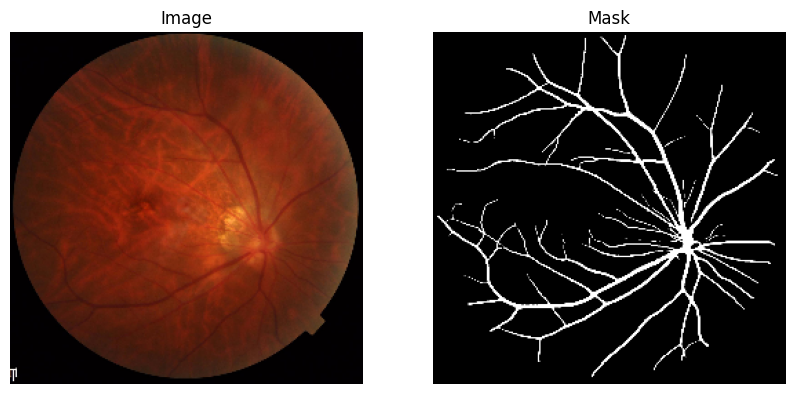

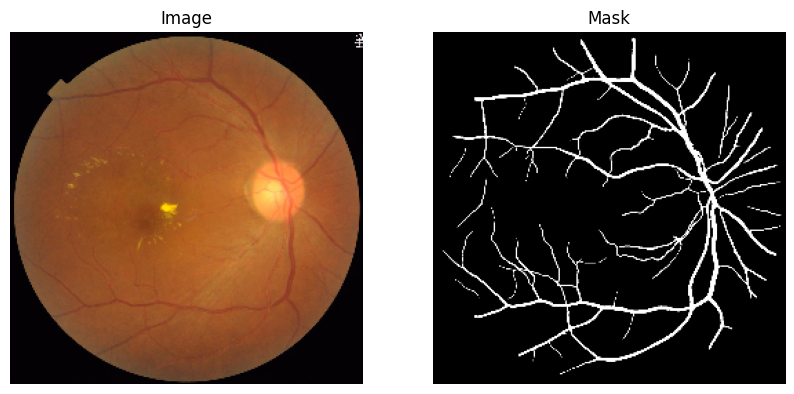

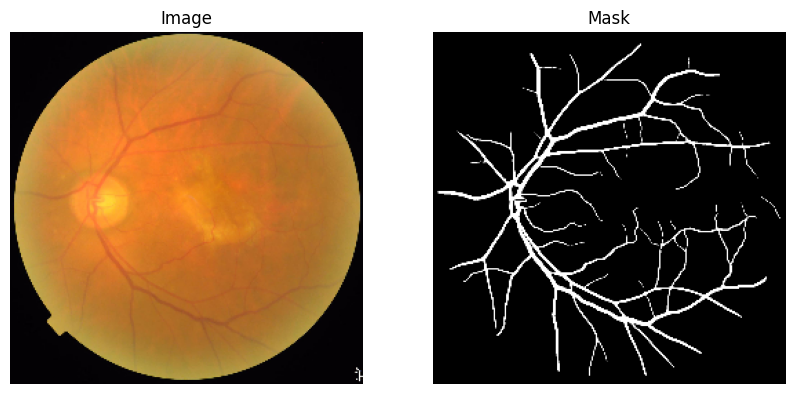

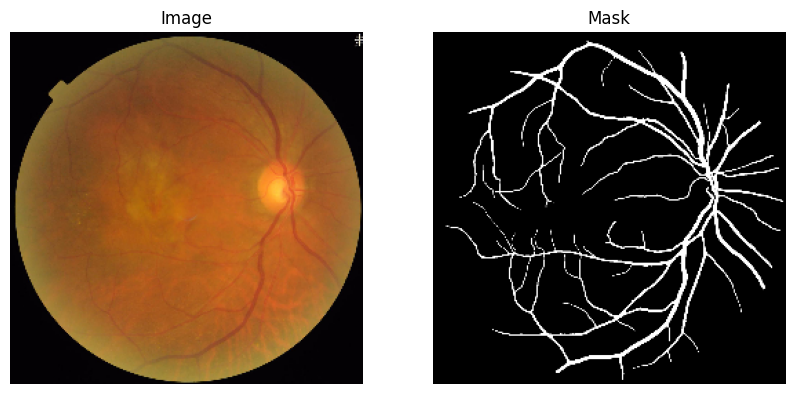

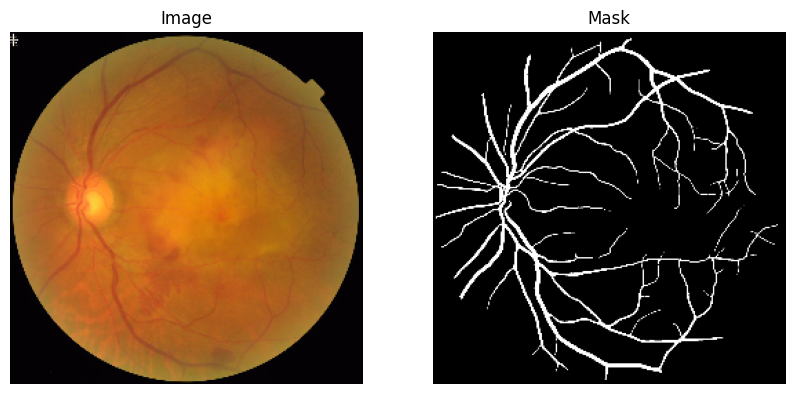

...

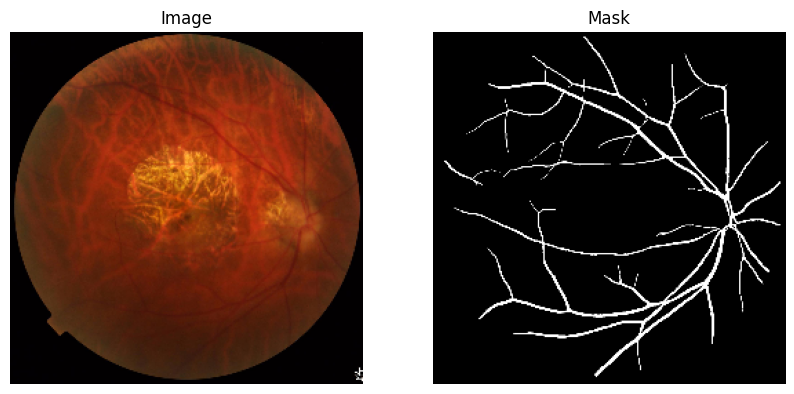

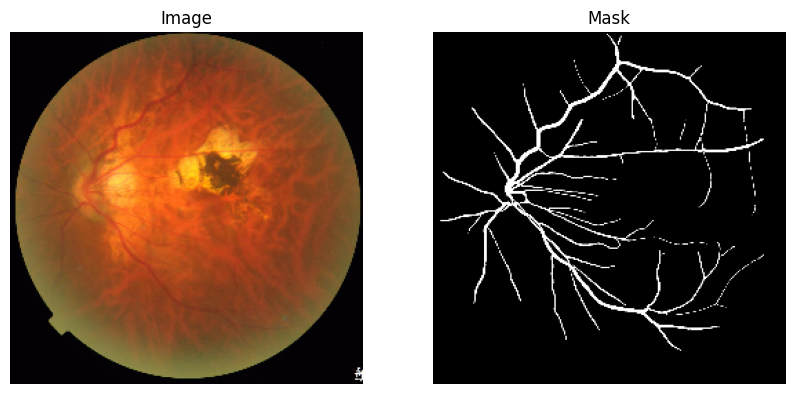

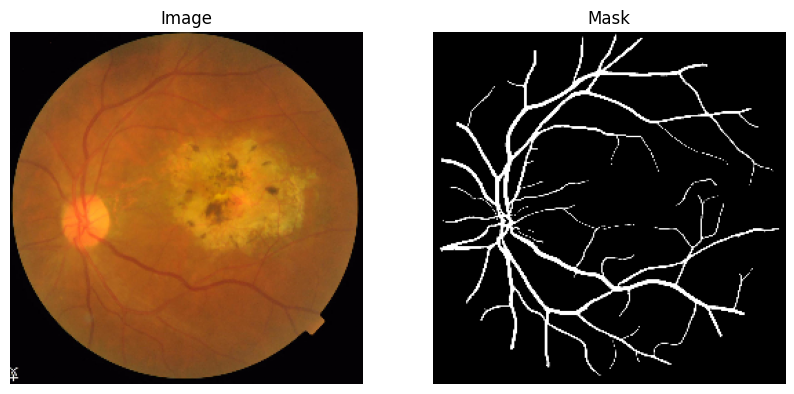

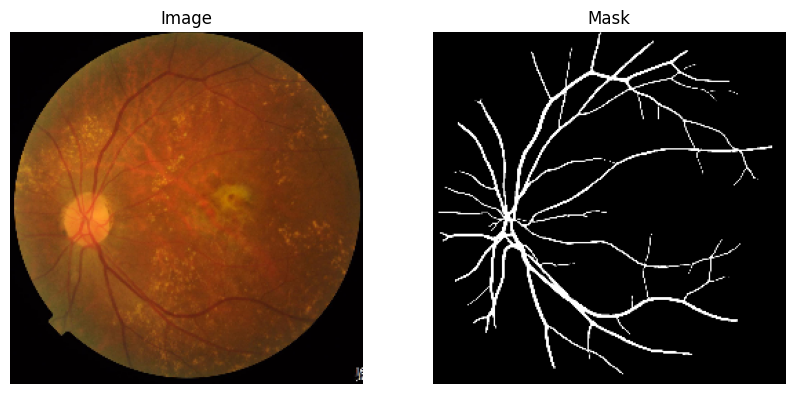

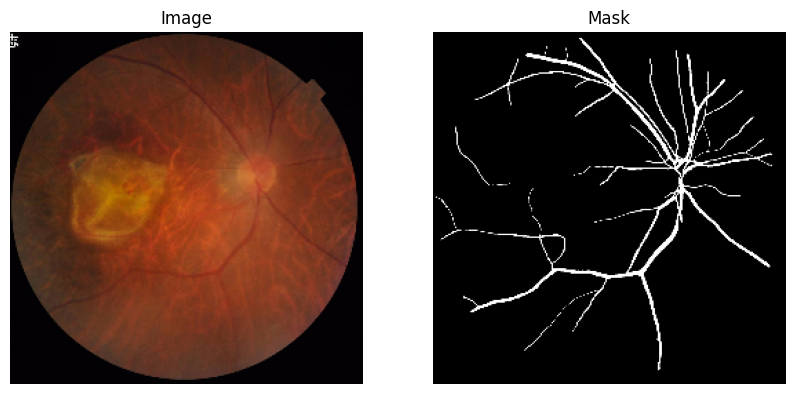

In [7]:
import matplotlib.pyplot as plt


plot_count = 0

for image_batch, mask_batch in train_dataset:
    batch_size = image_batch.shape[0]
    for i in range(batch_size):
        if plot_count >= 30:
            break  # Stop after plotting 30 images

        plt.figure(figsize=(10, 5))

        plt.subplot(1, 2, 1)
        plt.imshow(image_batch[i].numpy())
        plt.title("Image")
        plt.axis('off')

        plt.subplot(1, 2, 2)
        plt.imshow(mask_batch[i].numpy(), cmap='gray')
        plt.title("Mask")
        plt.axis('off')

        plt.show()

        plot_count += 1

    if plot_count >= 30:
        break


In [8]:
import numpy as np

def show_images(data, model=None, explain=False, n_images=6, SIZE=(25,10)):

    # Plot Configurations
    if model is not None:
        if explain:
            n_cols = 8
        else:
            n_cols = 4
    else:
        n_cols = 3

    # Iterate through data
    for plot_no in range(1, n_images+1):
        for index, (images, masks) in enumerate(iter(data)):

            # Select Items
            id = np.random.randint(len(images))
            image, mask = images[id], masks[id]

            if model is not None:

                if explain:

                    # Make Prediction
                    pred_mask = model.predict(image[np.newaxis, ...])[0]


                    # print("predicted: ", pred_mask)
                    # print("true value: ", )

                    image_numpy = image.numpy()

                    image_with_batch = image_numpy[np.newaxis, ...]

                    # Grad CAM
                    cam = GradCAM()
                    cam = cam.explain(
                        validation_data=(image_with_batch, masks[id]),
                        model=model,
                        class_index=1,
                        layer_name="OutputMask",
                        image_weight=0.5
                    )

                    # Figure
                    plt.figure(figsize=SIZE)

                    # Original Image
                    plt.subplot(1, n_cols, 1)
                    plt.imshow(image)
                    plt.axis('off')
                    plt.title("Original Image")

                    # Original Mask
                    plt.subplot(1, n_cols, 2)
                    plt.imshow(mask, cmap='gray')
                    plt.axis('off')
                    plt.title('Original Mask')

                    # Predicted Mask
                    plt.subplot(1, n_cols, 3)
                    plt.imshow(pred_mask, cmap='gray')
                    plt.axis('off')
                    plt.title("Predicted Mask")

                    # Mixed
                    plt.subplot(1, n_cols, 4)
                    plt.imshow(image)
                    plt.imshow(pred_mask, alpha=0.4)
                    plt.axis('off')
                    plt.title("Overlaped Prediction")

                    # Mixed
                    plt.subplot(1, n_cols, 5)
                    plt.imshow(cam)
                    plt.axis('off')
                    plt.title("Grad CAM")

                    # Show Image
                    plt.show()

                else:
                    # Make Prediction
                    pred_mask = model.predict(image[np.newaxis, ...])[0]


                    # Figure
                    plt.figure(figsize=SIZE)

                    # Original Image
                    plt.subplot(1, n_cols, 1)
                    plt.imshow(image)
                    plt.axis('off')
                    plt.title("Original Image")

                    # Original Mask
                    plt.subplot(1, n_cols, 2)
                    plt.imshow(mask, cmap='gray')
                    plt.axis('off')
                    plt.title('Original Mask')

                    # Predicted Mask
                    plt.subplot(1, n_cols, 3)
                    plt.imshow(pred_mask, cmap='gray')
                    plt.axis('off')
                    plt.title("Predicted Mask")

                    # Mixed
                    plt.subplot(1, n_cols, 4)
                    plt.imshow(image)
                    plt.imshow(pred_mask, alpha=0.4)
                    plt.axis('off')
                    plt.title("Overlaped Prediction")

                    # Show Image
                    plt.show()

            else:

                # Figure
                plt.figure(figsize=SIZE)

                # Original Image
                plt.subplot(1, n_cols, 1)
                plt.imshow(image)
                plt.axis('off')
                plt.title("Original Image")

                # Original Mask
                plt.subplot(1, n_cols, 2)
                plt.imshow(mask, cmap='gray')
                plt.axis('off')
                plt.title('Original Mask')

                # Mixed
                plt.subplot(1, n_cols, 3)
                plt.imshow(image)
                plt.imshow(mask, alpha=0.4)
                plt.axis('off')
                plt.title("Overlaped Image")

                # Show Image
                plt.show()

            # Break Loop
            break

In [9]:
from IPython.display import clear_output as cls
!pip install tf_explain
cls()


In [10]:
import os
import keras
import numpy as np

# Data Visualization
import matplotlib.pyplot as plt

# Model
from keras.layers import ReLU
from keras.layers import Input
from keras.layers import Layer
from keras.layers import Conv2D
from keras.layers import Concatenate
from keras.layers import UpSampling2D
from keras.layers import AveragePooling2D
from keras.models import Sequential, Model
from keras.layers import BatchNormalization

# Pretrained Model
from tensorflow.keras.applications import Xception
from tensorflow.keras.layers import ZeroPadding2D

# Callbacks
from keras.callbacks import Callback, ModelCheckpoint

# Model Visualization
from tensorflow.keras.utils import plot_model

# Model Explaination
from tf_explain.core.grad_cam import GradCAM

In [11]:
@keras.utils.register_keras_serializable(package="Custom", name="ConvBlock")

class ConvBlock(Layer):

    def __init__(self, filters=256, kernel_size=3, dilation_rate=1, **kwargs):
        super(ConvBlock, self).__init__(**kwargs)

        self.filters = filters
        self.kernel_size = kernel_size
        self.dilation_rate = dilation_rate

        self.net = Sequential([
            Conv2D(filters, kernel_size=kernel_size, padding='same', dilation_rate=dilation_rate, use_bias=False, kernel_initializer='he_normal'),
            BatchNormalization(),
            ReLU()
        ])

    def call(self, X):
        return self.net(X)

    def get_config(self):
        base_config = super().get_config()
        return {
            **base_config,
            "filters":self.filters,
            "kernel_size":self.kernel_size,
            "dilation_rate":self.dilation_rate,
        }


In [12]:
def AtrousSpatialPyramidPooling(X):
    B, H, W, C = X.shape

    # Image Pooling
    image_pool = AveragePooling2D(pool_size=(H, W), name="ASPP-AvgPool")(X)
    image_pool = ConvBlock(kernel_size=1, name="ASPP-ImagePool-CB")(image_pool)
    image_pool = UpSampling2D(size=(H//image_pool.shape[1], W//image_pool.shape[2]), name="ASPP-ImagePool-UpSample")(image_pool)

    # Atrous Oprtations
    conv_1  = ConvBlock(kernel_size=1, dilation_rate=1, name="ASPP-CB-1")(X)
    conv_6  = ConvBlock(kernel_size=3, dilation_rate=6, name="ASPP-CB-6")(X)
    conv_12 = ConvBlock(kernel_size=3, dilation_rate=12, name="ASPP-CB-12")(X)
    conv_18 = ConvBlock(kernel_size=3, dilation_rate=18, name="ASPP-CB-18")(X)

    # Combine All
    combined = Concatenate(name="ASPP-Combine")([image_pool, conv_1, conv_6, conv_12, conv_18])
    processed = ConvBlock(kernel_size=1, name="ASPP-Net")(combined)

    # Final Output
    return processed

In [13]:

IMAGE_SIZE = 256

# Input
InputL = Input(shape=(IMAGE_SIZE, IMAGE_SIZE, 3), name="InputLayer")

# Base Mode
backbone = Xception(include_top=False, weights='imagenet', input_tensor=InputL)

# ASPP Phase
DCNN = backbone.get_layer('block11_sepconv1').output
print(DCNN.shape)
ASPP = AtrousSpatialPyramidPooling(DCNN)
ASPP = UpSampling2D(size=(IMAGE_SIZE//4//ASPP.shape[1], IMAGE_SIZE//4//ASPP.shape[2]), name="AtrousSpatial")(ASPP)
print(ASPP.shape)
# LLF Phase
LLF = backbone.get_layer('block3_sepconv1').output
LLF = ZeroPadding2D(padding=((0, 1), (0, 1)))(LLF)
LLF = ConvBlock(filters=50, kernel_size=1,name="LLF-ConvBlock")(LLF)
print(LLF.shape)

# Combined
combined = Concatenate(axis=-1, name="Combine-LLF-ASPP")([ASPP, LLF])
features = ConvBlock(name="Top-ConvBlock-1")(combined)
features = ConvBlock(name="Top-ConvBlock-2")(features)
upsample = UpSampling2D(size=(IMAGE_SIZE//features.shape[1], IMAGE_SIZE//features.shape[1]), interpolation='bilinear', name="Top-UpSample")(features)

# Output Mask
PredMask = Conv2D(1, kernel_size=3, strides=1, padding='same', activation='sigmoid', use_bias=False, name="OutputMask")(upsample)

# DeelLabV3+ Model
model = Model(InputL, PredMask, name="DeepLabV3-Plus")
model.summary()

(None, 16, 16, 728)
(None, 64, 64, 256)
(None, 64, 64, 50)
Model: "DeepLabV3-Plus"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 InputLayer (InputLayer)     [(None, 256, 256, 3)]        0         []                            
                                                                                                  
 block1_conv1 (Conv2D)       (None, 127, 127, 32)         864       ['InputLayer[0][0]']          
                                                                                                  
 block1_conv1_bn (BatchNorm  (None, 127, 127, 32)         128       ['block1_conv1[0][0]']        
 alization)                                                                                       
                                                                                                  
 block1_conv1_act (Activat

In [14]:
# # Input
# InputL = Input(shape=(IMAGE_SIZE, IMAGE_SIZE, 3), name="InputLayer")

# # Base Mode
# backbone = Xception(include_top=False, weights='imagenet', input_tensor=InputL)

# # ASPP Phase
# DCNN = backbone.get_layer('block12_sepconv2_bn').output

# model = Model(InputL, DCNN, name="Xception")
# model.summary()

In [15]:
import keras
from keras import backend as K

def dice_coef(y_true, y_pred, smooth=1):
    y_true_f = K.flatten(y_true)
    y_pred_f = K.flatten(y_pred)
    intersection = K.sum(y_true_f * y_pred_f)
    return (2. * intersection + smooth) / (K.sum(y_true_f) + K.sum(y_pred_f) + smooth)

def dice_loss(y_true, y_pred):
    smooth = 1.
    y_true_f = K.flatten(y_true)
    y_pred_f = K.flatten(y_pred)
    intersection = y_true_f * y_pred_f
    score = (2. * K.sum(intersection) + smooth) / (K.sum(y_true_f) + K.sum(y_pred_f) + smooth)
    return 1. - score

def bce_dice_loss(y_true, y_pred):
    return tf.keras.losses.binary_crossentropy(y_true, y_pred) + dice_loss(y_true, y_pred)

keras.utils.get_custom_objects()['bce_dice_loss'] = bce_dice_loss



In [16]:

model.compile(optimizer = tf.keras.optimizers.Adam(learning_rate=0.001), loss = bce_dice_loss, metrics=[dice_coef, "accuracy"])


Epoch 1/100
 6/60 [==>...........................] - ETA: 6s - loss: 1.5327 - dice_coef: 0.1229 - accuracy: 0.6713

60/60 [==============================] - ETA: 0s - loss: 0.7490 - dice_coef: 0.4734 - accuracy: 0.9070

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


60/60 [==============================] - 49s 272ms/step - loss: 0.7490 - dice_coef: 0.4734 - accuracy: 0.9070 - val_loss: 1.0580 - val_dice_coef: 0.3583 - val_accuracy: 0.8265
Epoch 2/100
60/60 [==============================] - 14s 232ms/step - loss: 0.4544 - dice_coef: 0.6676 - accuracy: 0.9526 - val_loss: 0.5763 - val_dice_coef: 0.5682 - val_accuracy: 0.9494
Epoch 3/100
60/60 [==============================] - 14s 228ms/step - loss: 0.3961 - dice_coef: 0.7110 - accuracy: 0.9582 - val_loss: 0.4875 - val_dice_coef: 0.6510 - val_accuracy: 0.9560
Epoch 4/100
60/60 [==============================] - 14s 236ms/step - loss: 0.3670 - dice_coef: 0.7333 - accuracy: 0.9608 - val_loss: 0.4592 - val_dice_coef: 0.6720 - val_accuracy: 0.9586
Epoch 5/100
60/60 [==============================] - 15s 229ms/step - loss: 0.3459 - dice_coef: 0.7492 - accuracy: 0.9627 - val_loss: 0.3939 - val_dice_coef: 0.7193 - val_accuracy: 0.9624
Epoch 6/100
60/60 [==============================] - 14s 227ms/step - lo

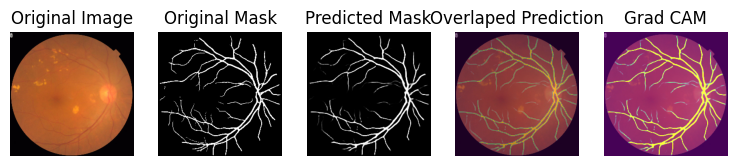

1/1 [==============================] - 0s 42ms/step


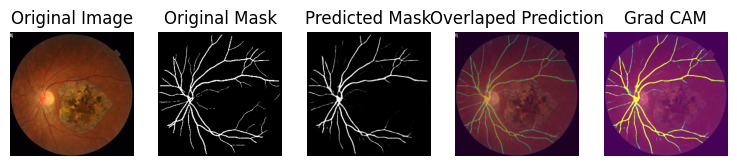

1/1 [==============================] - 0s 81ms/step


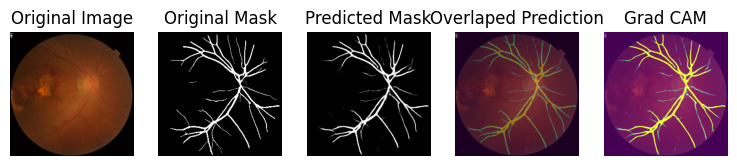

60/60 [==============================] - 19s 320ms/step - loss: 0.2977 - dice_coef: 0.7863 - accuracy: 0.9669 - val_loss: 0.3263 - val_dice_coef: 0.7583 - val_accuracy: 0.9667
Epoch 11/100
60/60 [==============================] - 14s 227ms/step - loss: 0.2893 - dice_coef: 0.7921 - accuracy: 0.9676 - val_loss: 0.3084 - val_dice_coef: 0.7705 - val_accuracy: 0.9681
Epoch 12/100
60/60 [==============================] - 14s 228ms/step - loss: 0.2849 - dice_coef: 0.7956 - accuracy: 0.9679 - val_loss: 0.2945 - val_dice_coef: 0.7846 - val_accuracy: 0.9688
Epoch 13/100
60/60 [==============================] - 13s 218ms/step - loss: 0.2833 - dice_coef: 0.7977 - accuracy: 0.9682 - val_loss: 0.2933 - val_dice_coef: 0.7898 - val_accuracy: 0.9679
Epoch 14/100
60/60 [==============================] - 14s 234ms/step - loss: 0.2793 - dice_coef: 0.8009 - accuracy: 0.9685 - val_loss: 0.2934 - val_dice_coef: 0.7871 - val_accuracy: 0.9690
Epoch 15/100
60/60 [==============================] - 14s 236ms/step

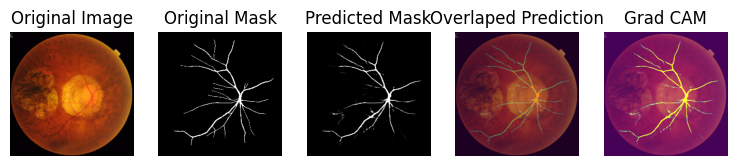

1/1 [==============================] - 0s 82ms/step


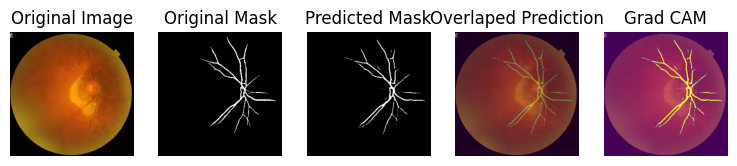

1/1 [==============================] - 0s 61ms/step


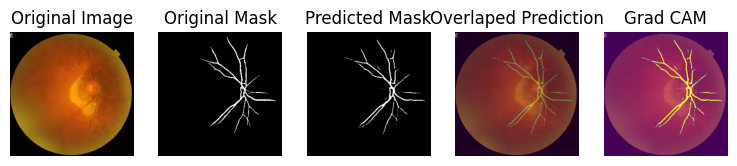

60/60 [==============================] - 16s 266ms/step - loss: 0.2657 - dice_coef: 0.8114 - accuracy: 0.9691 - val_loss: 0.3069 - val_dice_coef: 0.7848 - val_accuracy: 0.9685
Epoch 21/100
60/60 [==============================] - 13s 218ms/step - loss: 0.2648 - dice_coef: 0.8120 - accuracy: 0.9694 - val_loss: 0.3161 - val_dice_coef: 0.7763 - val_accuracy: 0.9680
Epoch 22/100
60/60 [==============================] - 13s 215ms/step - loss: 0.2586 - dice_coef: 0.8164 - accuracy: 0.9701 - val_loss: 0.3085 - val_dice_coef: 0.7823 - val_accuracy: 0.9687
Epoch 23/100
60/60 [==============================] - 13s 216ms/step - loss: 0.2513 - dice_coef: 0.8207 - accuracy: 0.9707 - val_loss: 0.2989 - val_dice_coef: 0.7878 - val_accuracy: 0.9693
Epoch 24/100
60/60 [==============================] - 13s 216ms/step - loss: 0.2489 - dice_coef: 0.8224 - accuracy: 0.9709 - val_loss: 0.3095 - val_dice_coef: 0.7849 - val_accuracy: 0.9687
Epoch 25/100
60/60 [==============================] - 13s 215ms/step

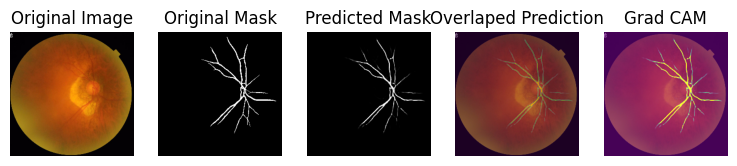

1/1 [==============================] - 0s 64ms/step


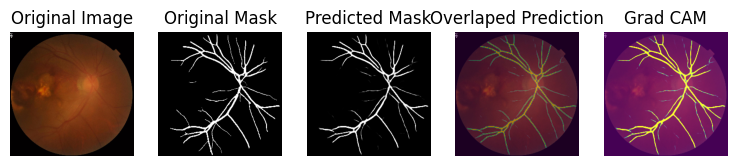

1/1 [==============================] - 0s 49ms/step


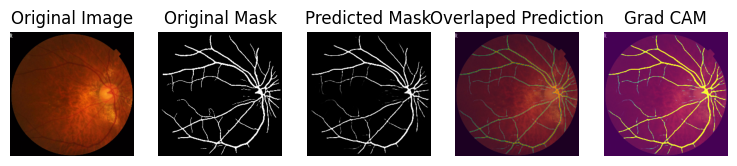

60/60 [==============================] - 16s 272ms/step - loss: 0.2319 - dice_coef: 0.8339 - accuracy: 0.9722 - val_loss: 0.3284 - val_dice_coef: 0.7750 - val_accuracy: 0.9676
Epoch 31/100
60/60 [==============================] - 13s 215ms/step - loss: 0.2310 - dice_coef: 0.8348 - accuracy: 0.9723 - val_loss: 0.3181 - val_dice_coef: 0.7779 - val_accuracy: 0.9681
Epoch 32/100
60/60 [==============================] - 14s 229ms/step - loss: 0.2314 - dice_coef: 0.8343 - accuracy: 0.9722 - val_loss: 0.2796 - val_dice_coef: 0.8106 - val_accuracy: 0.9710
Epoch 33/100
60/60 [==============================] - 14s 237ms/step - loss: 0.2316 - dice_coef: 0.8349 - accuracy: 0.9722 - val_loss: 0.2686 - val_dice_coef: 0.8167 - val_accuracy: 0.9712
Epoch 34/100
60/60 [==============================] - 13s 215ms/step - loss: 0.2313 - dice_coef: 0.8348 - accuracy: 0.9721 - val_loss: 0.2851 - val_dice_coef: 0.8048 - val_accuracy: 0.9704
Epoch 35/100
60/60 [==============================] - 14s 223ms/step

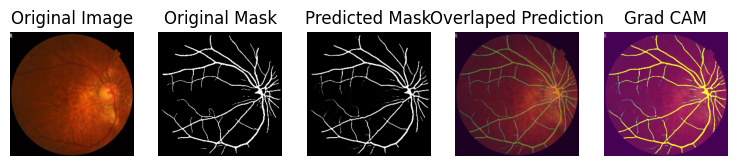

1/1 [==============================] - 0s 41ms/step


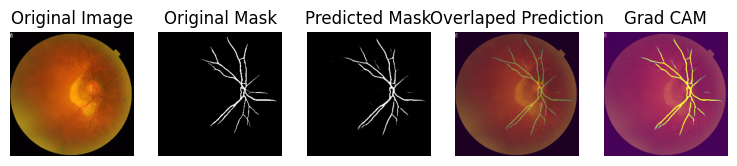

1/1 [==============================] - 0s 37ms/step


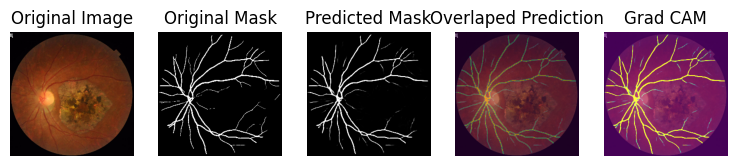

60/60 [==============================] - 17s 274ms/step - loss: 0.2213 - dice_coef: 0.8412 - accuracy: 0.9729 - val_loss: 0.2730 - val_dice_coef: 0.8117 - val_accuracy: 0.9711
Epoch 41/100
60/60 [==============================] - 13s 217ms/step - loss: 0.2205 - dice_coef: 0.8417 - accuracy: 0.9729 - val_loss: 0.2803 - val_dice_coef: 0.8137 - val_accuracy: 0.9708
Epoch 42/100
60/60 [==============================] - 13s 217ms/step - loss: 0.2210 - dice_coef: 0.8416 - accuracy: 0.9729 - val_loss: 0.2860 - val_dice_coef: 0.8095 - val_accuracy: 0.9705
Epoch 43/100
60/60 [==============================] - 13s 218ms/step - loss: 0.2210 - dice_coef: 0.8417 - accuracy: 0.9729 - val_loss: 0.2897 - val_dice_coef: 0.8047 - val_accuracy: 0.9704
Epoch 44/100
60/60 [==============================] - 13s 215ms/step - loss: 0.2179 - dice_coef: 0.8438 - accuracy: 0.9732 - val_loss: 0.2998 - val_dice_coef: 0.7991 - val_accuracy: 0.9699
Epoch 45/100
60/60 [==============================] - 13s 216ms/step

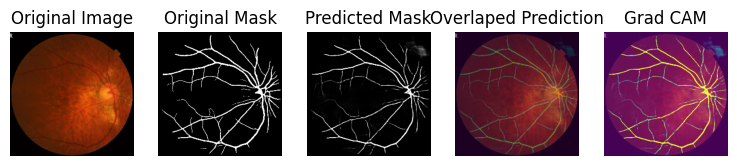

1/1 [==============================] - 0s 58ms/step


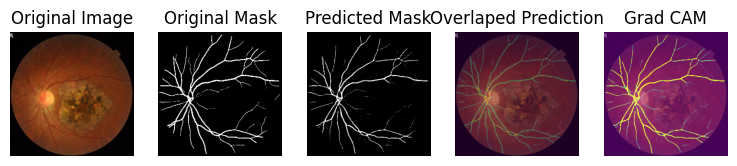

1/1 [==============================] - 0s 49ms/step


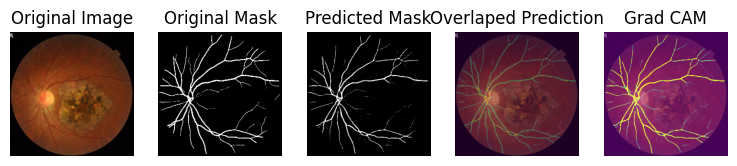

60/60 [==============================] - 16s 268ms/step - loss: 0.2313 - dice_coef: 0.8371 - accuracy: 0.9717 - val_loss: 0.3850 - val_dice_coef: 0.7336 - val_accuracy: 0.9640
Epoch 51/100
60/60 [==============================] - 13s 219ms/step - loss: 0.2323 - dice_coef: 0.8357 - accuracy: 0.9715 - val_loss: 0.3187 - val_dice_coef: 0.7902 - val_accuracy: 0.9686
Epoch 52/100
60/60 [==============================] - 13s 221ms/step - loss: 0.2277 - dice_coef: 0.8378 - accuracy: 0.9720 - val_loss: 0.2896 - val_dice_coef: 0.8093 - val_accuracy: 0.9703
Epoch 53/100
60/60 [==============================] - 14s 235ms/step - loss: 0.2163 - dice_coef: 0.8446 - accuracy: 0.9732 - val_loss: 0.2640 - val_dice_coef: 0.8257 - val_accuracy: 0.9716
Epoch 54/100
60/60 [==============================] - 14s 217ms/step - loss: 0.2100 - dice_coef: 0.8487 - accuracy: 0.9738 - val_loss: 0.2647 - val_dice_coef: 0.8237 - val_accuracy: 0.9715
Epoch 55/100
60/60 [==============================] - 14s 230ms/step

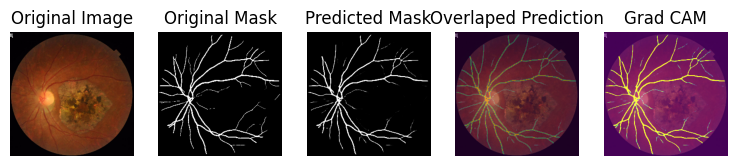

1/1 [==============================] - 0s 77ms/step


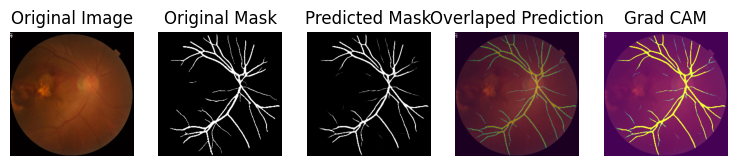

1/1 [==============================] - 0s 40ms/step


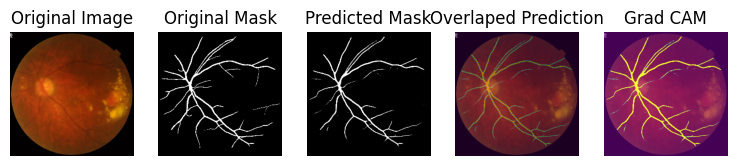

60/60 [==============================] - 17s 273ms/step - loss: 0.1954 - dice_coef: 0.8591 - accuracy: 0.9750 - val_loss: 0.2829 - val_dice_coef: 0.8197 - val_accuracy: 0.9714
Epoch 61/100
60/60 [==============================] - 13s 217ms/step - loss: 0.2064 - dice_coef: 0.8529 - accuracy: 0.9739 - val_loss: 0.3036 - val_dice_coef: 0.8055 - val_accuracy: 0.9693
Epoch 62/100
60/60 [==============================] - 13s 215ms/step - loss: 0.2155 - dice_coef: 0.8478 - accuracy: 0.9735 - val_loss: 0.2945 - val_dice_coef: 0.8059 - val_accuracy: 0.9704
Epoch 63/100
60/60 [==============================] - 13s 217ms/step - loss: 0.2023 - dice_coef: 0.8552 - accuracy: 0.9746 - val_loss: 0.2895 - val_dice_coef: 0.8085 - val_accuracy: 0.9707
Epoch 64/100
60/60 [==============================] - 13s 217ms/step - loss: 0.2018 - dice_coef: 0.8555 - accuracy: 0.9744 - val_loss: 0.2856 - val_dice_coef: 0.8094 - val_accuracy: 0.9707
Epoch 65/100
60/60 [==============================] - 13s 220ms/step

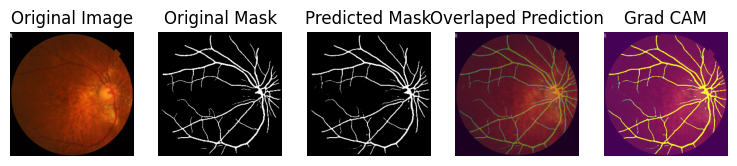

1/1 [==============================] - 0s 51ms/step


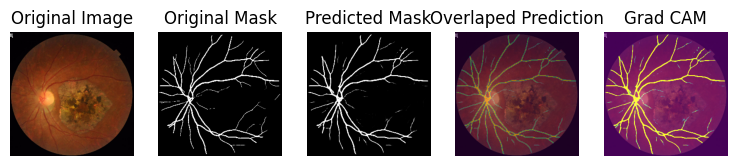

1/1 [==============================] - 0s 70ms/step


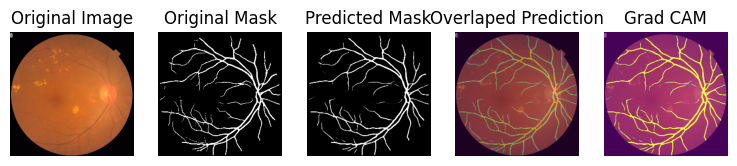

60/60 [==============================] - 16s 268ms/step - loss: 0.1972 - dice_coef: 0.8579 - accuracy: 0.9748 - val_loss: 0.2589 - val_dice_coef: 0.8379 - val_accuracy: 0.9720
Epoch 71/100
60/60 [==============================] - 13s 218ms/step - loss: 0.1906 - dice_coef: 0.8622 - accuracy: 0.9754 - val_loss: 0.2641 - val_dice_coef: 0.8336 - val_accuracy: 0.9722
Epoch 72/100
60/60 [==============================] - 13s 218ms/step - loss: 0.1869 - dice_coef: 0.8646 - accuracy: 0.9758 - val_loss: 0.2665 - val_dice_coef: 0.8321 - val_accuracy: 0.9721
Epoch 73/100
60/60 [==============================] - 13s 218ms/step - loss: 0.1875 - dice_coef: 0.8644 - accuracy: 0.9757 - val_loss: 0.2654 - val_dice_coef: 0.8329 - val_accuracy: 0.9721
Epoch 74/100
60/60 [==============================] - 13s 218ms/step - loss: 0.1931 - dice_coef: 0.8614 - accuracy: 0.9752 - val_loss: 0.2834 - val_dice_coef: 0.8209 - val_accuracy: 0.9710
Epoch 75/100
60/60 [==============================] - 13s 215ms/step

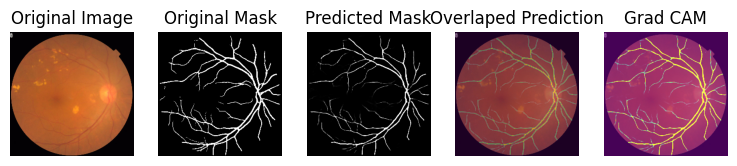

1/1 [==============================] - 0s 40ms/step


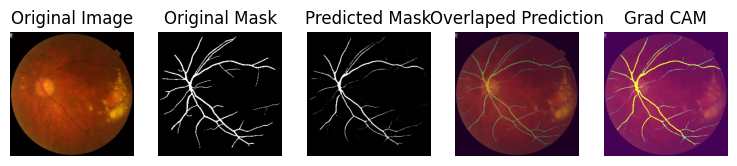

1/1 [==============================] - 0s 47ms/step


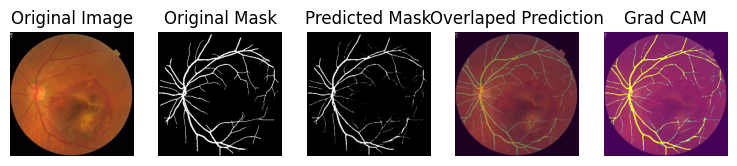

60/60 [==============================] - 16s 270ms/step - loss: 0.2144 - dice_coef: 0.8487 - accuracy: 0.9729 - val_loss: 0.4090 - val_dice_coef: 0.7141 - val_accuracy: 0.9614
Epoch 81/100
60/60 [==============================] - 13s 217ms/step - loss: 0.2079 - dice_coef: 0.8519 - accuracy: 0.9736 - val_loss: 0.3863 - val_dice_coef: 0.7536 - val_accuracy: 0.9649
Epoch 82/100
60/60 [==============================] - 13s 217ms/step - loss: 0.2149 - dice_coef: 0.8480 - accuracy: 0.9729 - val_loss: 0.3571 - val_dice_coef: 0.7654 - val_accuracy: 0.9662
Epoch 83/100
60/60 [==============================] - 13s 221ms/step - loss: 0.2009 - dice_coef: 0.8555 - accuracy: 0.9743 - val_loss: 0.3160 - val_dice_coef: 0.8001 - val_accuracy: 0.9696
Epoch 84/100
60/60 [==============================] - 13s 221ms/step - loss: 0.1918 - dice_coef: 0.8614 - accuracy: 0.9752 - val_loss: 0.2978 - val_dice_coef: 0.8114 - val_accuracy: 0.9707
Epoch 85/100
60/60 [==============================] - 13s 222ms/step

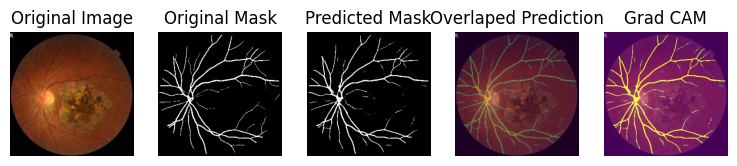

1/1 [==============================] - 0s 52ms/step


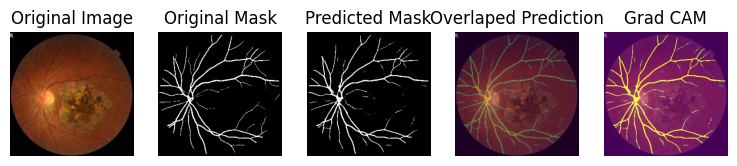

1/1 [==============================] - 0s 48ms/step


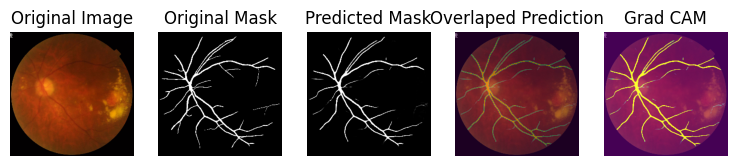

60/60 [==============================] - 16s 270ms/step - loss: 0.1829 - dice_coef: 0.8680 - accuracy: 0.9759 - val_loss: 0.2756 - val_dice_coef: 0.8339 - val_accuracy: 0.9715
Epoch 91/100
60/60 [==============================] - 13s 219ms/step - loss: 0.1865 - dice_coef: 0.8656 - accuracy: 0.9756 - val_loss: 0.2790 - val_dice_coef: 0.8283 - val_accuracy: 0.9696
Epoch 92/100
60/60 [==============================] - 13s 220ms/step - loss: 0.1947 - dice_coef: 0.8609 - accuracy: 0.9748 - val_loss: 0.2746 - val_dice_coef: 0.8271 - val_accuracy: 0.9708
Epoch 93/100
60/60 [==============================] - 15s 240ms/step - loss: 0.1880 - dice_coef: 0.8648 - accuracy: 0.9755 - val_loss: 0.2760 - val_dice_coef: 0.8241 - val_accuracy: 0.9703
Epoch 94/100
60/60 [==============================] - 14s 234ms/step - loss: 0.1903 - dice_coef: 0.8635 - accuracy: 0.9752 - val_loss: 0.2788 - val_dice_coef: 0.8247 - val_accuracy: 0.9710
Epoch 95/100
60/60 [==============================] - 13s 221ms/step

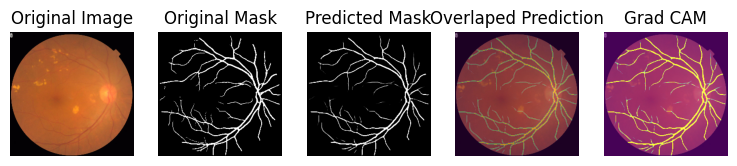

1/1 [==============================] - 0s 46ms/step


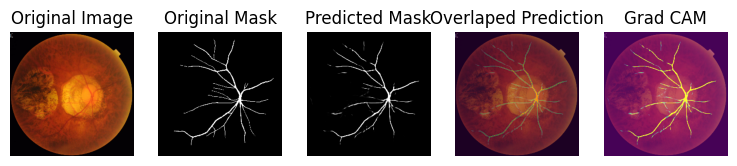

1/1 [==============================] - 0s 43ms/step


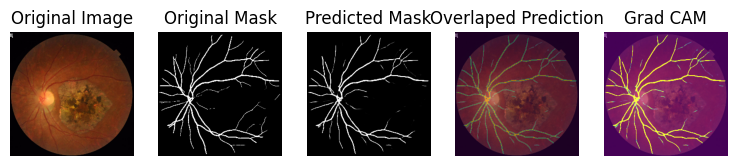

60/60 [==============================] - 17s 278ms/step - loss: 0.1968 - dice_coef: 0.8598 - accuracy: 0.9745 - val_loss: 0.3540 - val_dice_coef: 0.7986 - val_accuracy: 0.9688


In [17]:
checkpoint = ModelCheckpoint(
    'Model_Xception_HF.h5',
    monitor='val_accuracy',
    custom_objects={'ConvBlock': ConvBlock},
    verbose=0,
    save_best_only=True,
    save_weights_only=False,
    mode='auto',
)
class ShowProgress(Callback):
    def on_epoch_end(self, epoch, logs=None):
        if (epoch+1)%10==0:
            show_images(val_dataset, model=self.model, explain=True, n_images=3, SIZE=(15,8))

history = model.fit(
    train_dataset,
    validation_data=val_dataset,
    callbacks=[checkpoint,  ShowProgress()],
    use_multiprocessing=False,
    workers=1,
    epochs=100
)

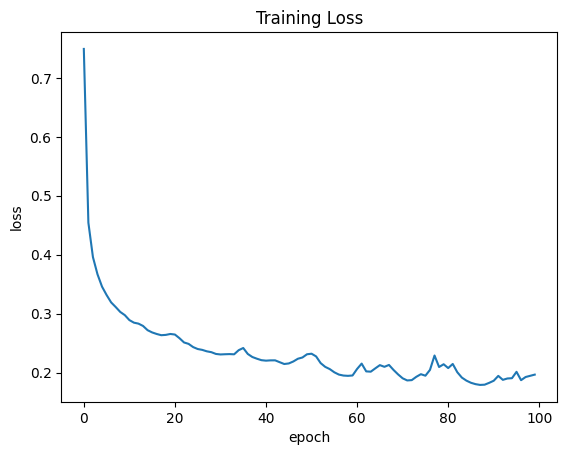

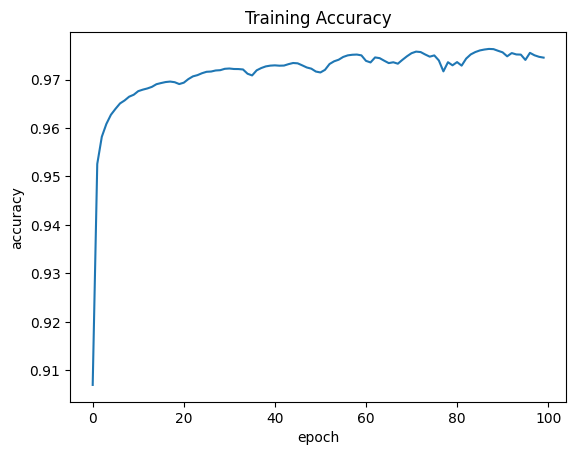

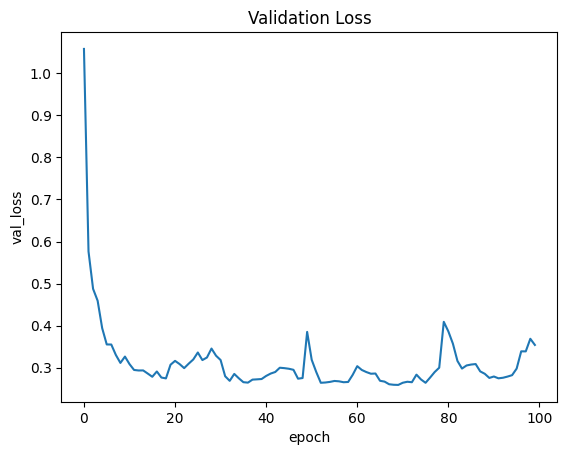

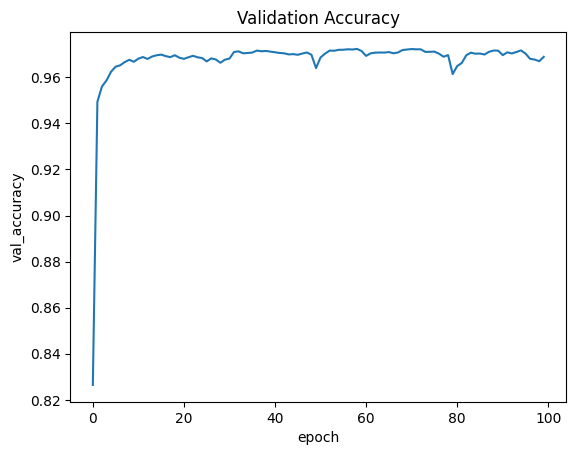

In [18]:
plt.plot(history.history["loss"])
plt.title("Training Loss")
plt.ylabel("loss")
plt.xlabel("epoch")
plt.show()

plt.plot(history.history["accuracy"])
plt.title("Training Accuracy")
plt.ylabel("accuracy")
plt.xlabel("epoch")
plt.show()

plt.plot(history.history["val_loss"])
plt.title("Validation Loss")
plt.ylabel("val_loss")
plt.xlabel("epoch")
plt.show()

plt.plot(history.history["val_accuracy"])
plt.title("Validation Accuracy")
plt.ylabel("val_accuracy")
plt.xlabel("epoch")
plt.show()

In [19]:
import tensorflow as tf

IMAGE_SIZE = 256
BATCH_SIZE = 8

def read_image(image_path, mask=False):
    image = tf.io.read_file(image_path)

    if mask:
        image = tf.image.decode_png(image, channels=1)
        image = tf.cast(image, tf.float32) / 255.0  # Normalize to [0, 1] for mask images
        image = tf.where(image >= 0.5, 1.0, 0.0)
        image = tf.image.resize(image, [IMAGE_SIZE, IMAGE_SIZE])
    else:
        image = tf.image.decode_png(image, channels=3)
        image = tf.cast(image, tf.float32) / 255.0  # Normalize to [0, 1] for RGB images

        image = tf.image.resize(image, [IMAGE_SIZE, IMAGE_SIZE])

    return image

def load_data(image_list, mask_list):
    image = read_image(image_list)
    mask = read_image(mask_list, mask=True)
    return image, mask

def data_generator(image_list, mask_list):
    dataset = tf.data.Dataset.from_tensor_slices((image_list, mask_list))
    dataset = dataset.map(load_data, num_parallel_calls=tf.data.AUTOTUNE)
    dataset = dataset.batch(BATCH_SIZE, drop_remainder=True)
    return dataset

test_dataset = data_generator(test_image_paths, test_mask_paths)

print("Test Dataset:", test_dataset)



Test Dataset: <_BatchDataset element_spec=(TensorSpec(shape=(8, 256, 256, 3), dtype=tf.float32, name=None), TensorSpec(shape=(8, 256, 256, 1), dtype=tf.float32, name=None))>


In [20]:
m1 = keras.models.load_model("/content/Model_Xception_HF.h5", custom_objects={'dice_coef': dice_coef})
dice_score = m1.evaluate(val_dataset, verbose=0)
print("Val Dice Score:", dice_score[1])

Val Dice Score: 0.8313838839530945


In [22]:

def calculate_metrics(model, test_dataset):
    accuracy_scores = []
    dice_scores = []
    tp_scores = []
    tn_scores = []
    fp_scores = []
    fn_scores = []

    for image, mask in test_dataset:

        pred_mask = model.predict(image)


        mask = mask.numpy()

        pred_mask_binary = (pred_mask > 0.5).astype(np.float32)

        mask_flat = mask.flatten()
        pred_mask_flat = pred_mask_binary.flatten()

        # Calculate True Positives, True Negatives, False Positives, and False Negatives
        tp = np.sum(mask_flat * pred_mask_flat)
        tn = np.sum((1 - mask_flat) * (1 - pred_mask_flat))
        fp = np.sum((1 - mask_flat) * pred_mask_flat)
        fn = np.sum(mask_flat * (1 - pred_mask_flat))

        # Calculate accuracy, Dice score
        accuracy = (tp + tn) / (tp + tn + fp + fn)
        dice = (2.0 * tp) / (2.0 * tp + fp + fn)

        accuracy_scores.append(accuracy)
        dice_scores.append(dice)
        tp_scores.append(tp)
        tn_scores.append(tn)
        fp_scores.append(fp)
        fn_scores.append(fn)

    # Calculate and print average accuracy and Dice scores
    avg_accuracy = np.mean(accuracy_scores)
    avg_dice = np.mean(dice_scores)

    print(f"Average Accuracy: {avg_accuracy:.4f}")
    print(f"Average Dice Score: {avg_dice:.4f}")

    TP = np.mean(tp_scores)
    TN = np.mean(tn_scores)
    FP = np.mean(fp_scores)
    FN = np.mean(fn_scores)

    f1 = 2 * TP / (2 * TP + FP + FN)
    recall = TP/(FN+TP)
    precision = TP/(TP+FP)
    specificity = TN/(FP+TN)
    MCC = (TP*TN - FP*FN)/ np.sqrt((TP+FP)*(TP+FN)*(TN+FP)*(TN+FN))

    print("Precision Score:", precision)
    print("Sensitivity/Recall Score:", recall)
    print("Specificity Score:", specificity)
    print("F1 Score:", f1)
    print("MCC :", MCC)

calculate_metrics(m1, test_dataset)


1/1 [==============================] - 0s 27ms/step
Average Accuracy: 0.9771
Average Dice Score: 0.8301
Precision Score: 0.8823172
Sensitivity/Recall Score: 0.78325707
Specificity Score: 0.9919918
F1 Score: 0.8298413368433868
MCC : 0.8192954


1/1 [==============================] - 0s 62ms/step


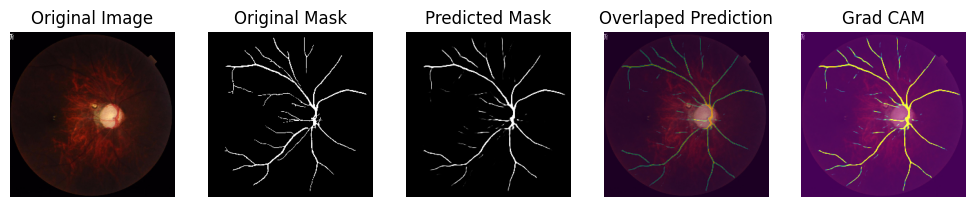

1/1 [==============================] - 0s 40ms/step


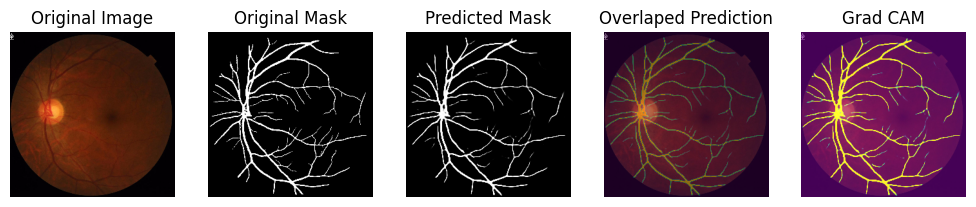

1/1 [==============================] - 0s 59ms/step


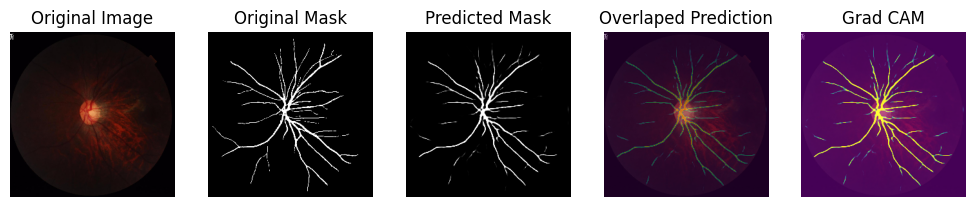

1/1 [==============================] - 0s 44ms/step


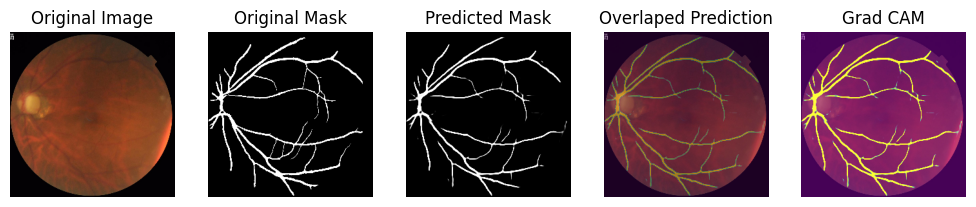

1/1 [==============================] - 0s 74ms/step


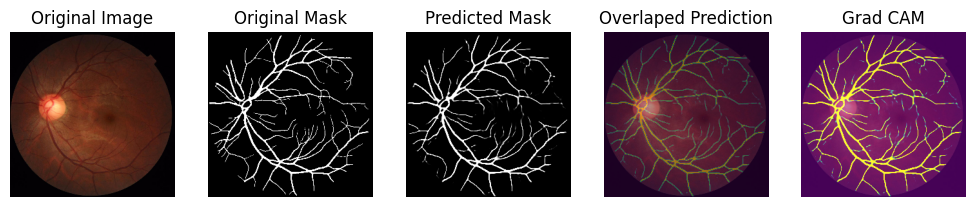

1/1 [==============================] - 0s 67ms/step


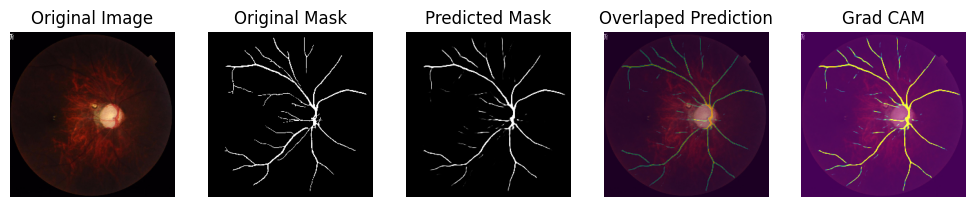

1/1 [==============================] - 0s 41ms/step


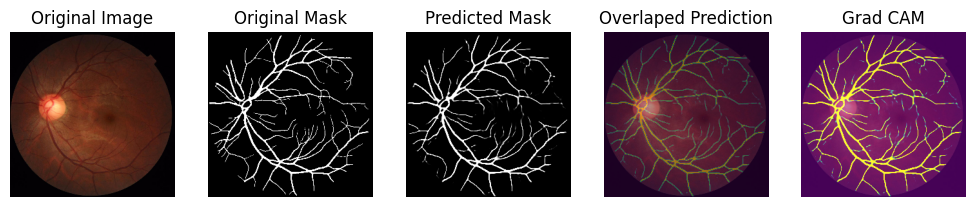

1/1 [==============================] - 0s 56ms/step


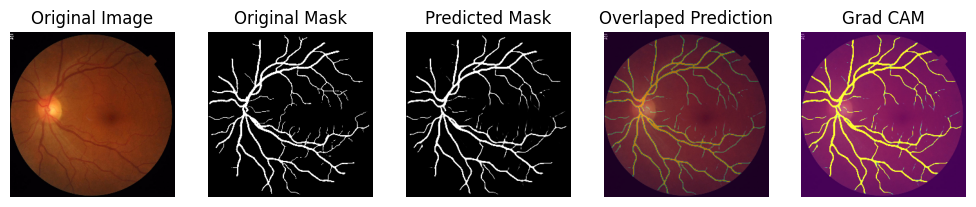

1/1 [==============================] - 0s 58ms/step


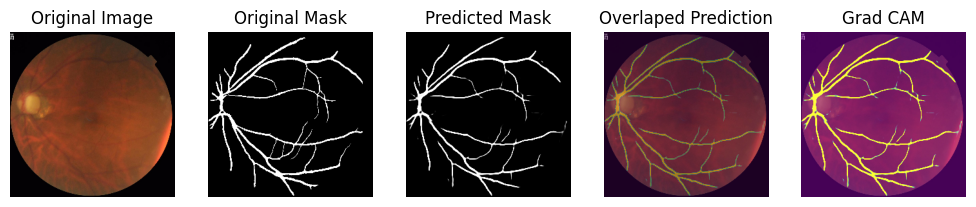

1/1 [==============================] - 0s 59ms/step


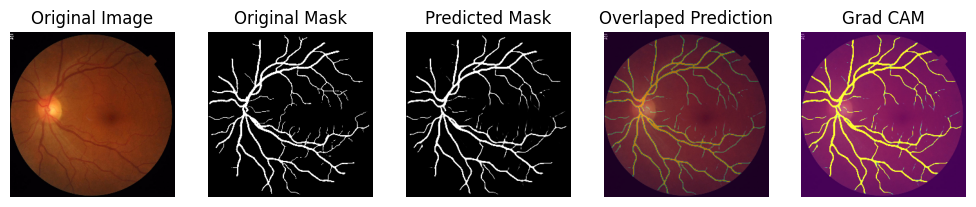

In [ ]:
show_images(test_dataset, model=m1, explain=True, n_images=10, SIZE=(20,8))

1/1 [==============================] - 0s 68ms/step


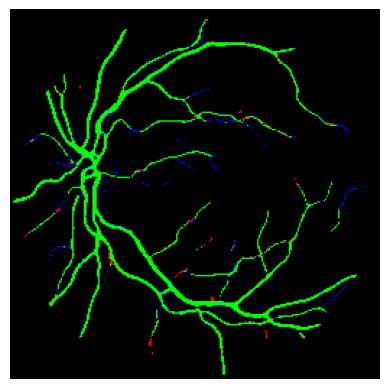

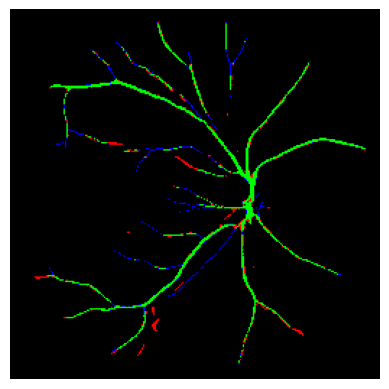

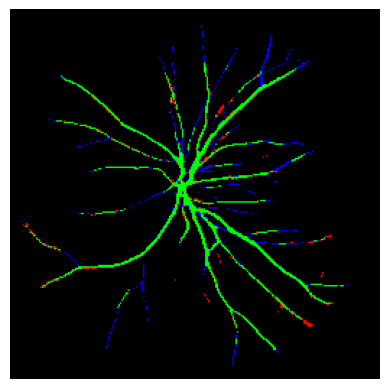

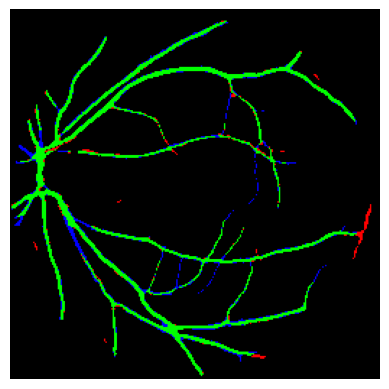

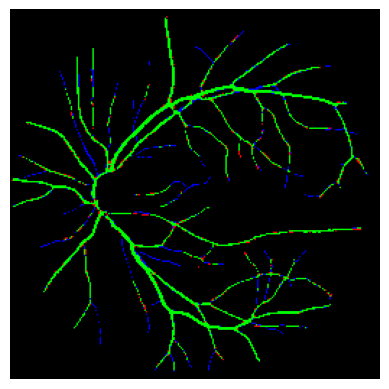

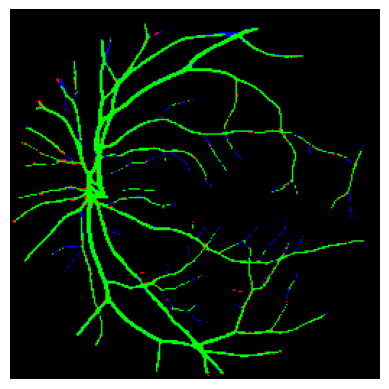

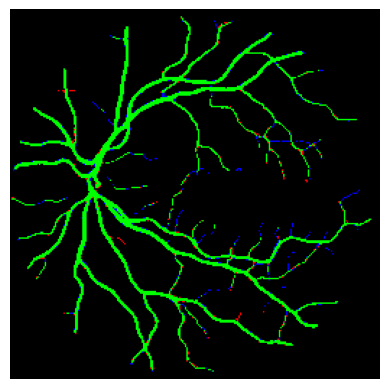

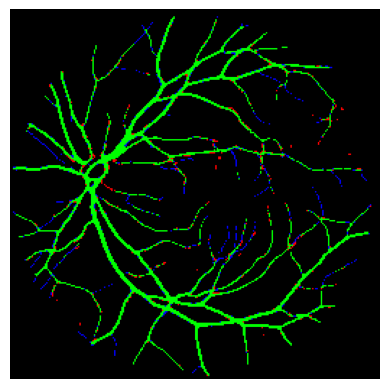

1/1 [==============================] - 0s 52ms/step


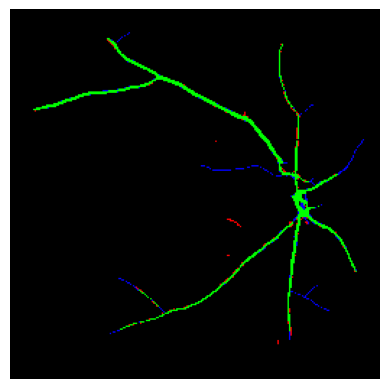

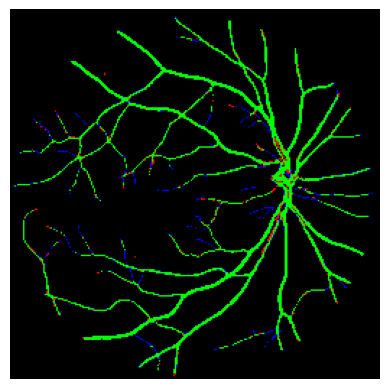

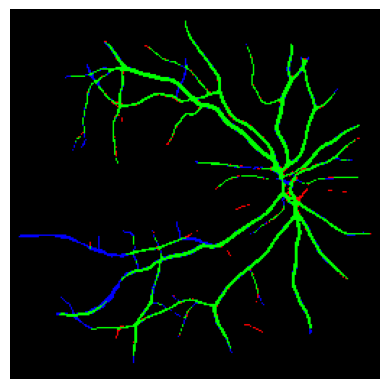

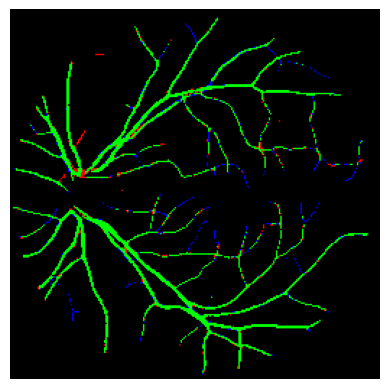

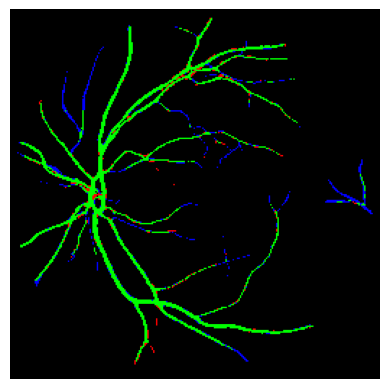

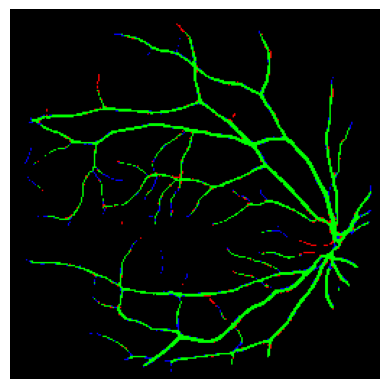

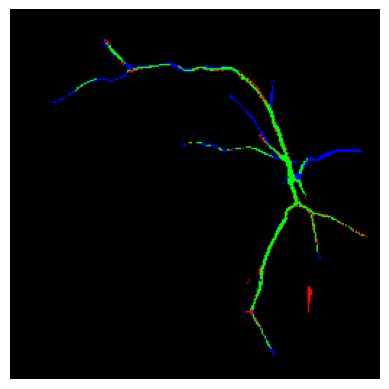

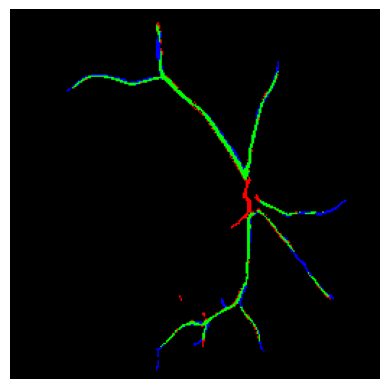

1/1 [==============================] - 0s 41ms/step


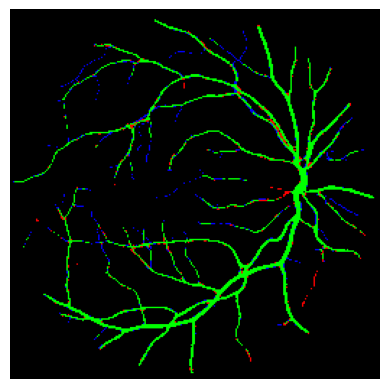

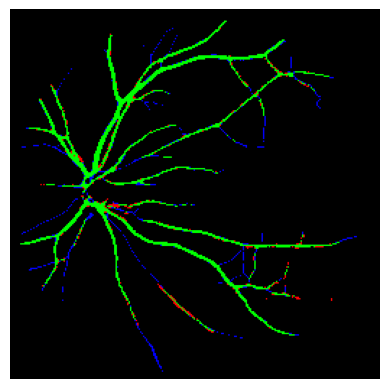

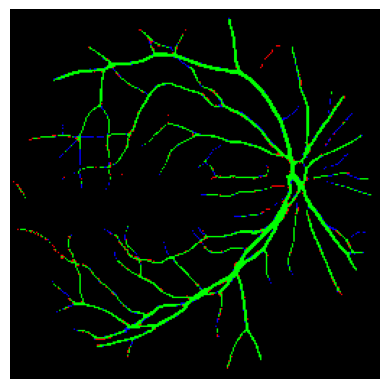

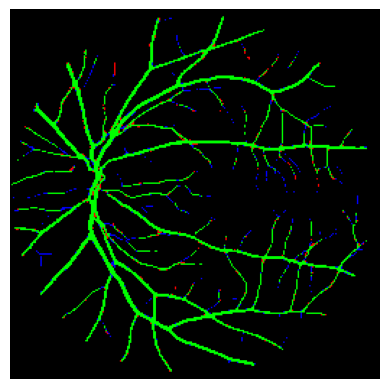

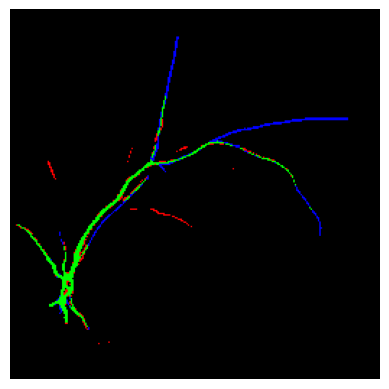

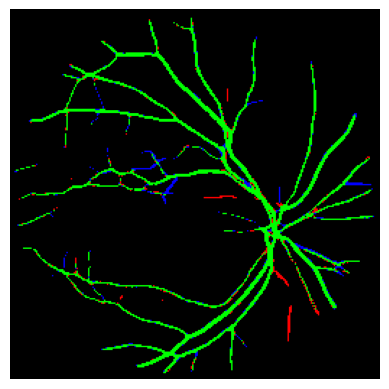

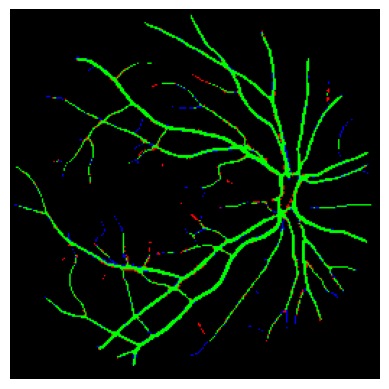

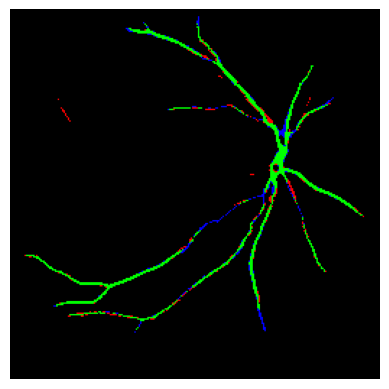

1/1 [==============================] - 0s 61ms/step


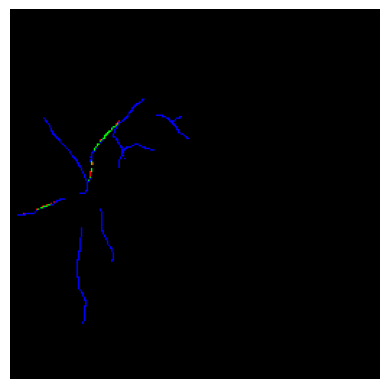

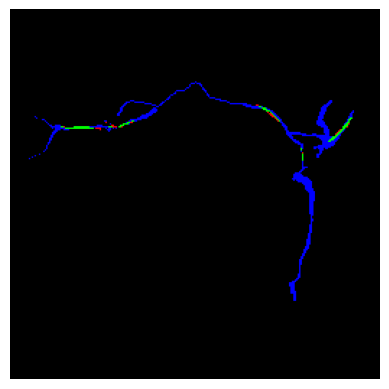

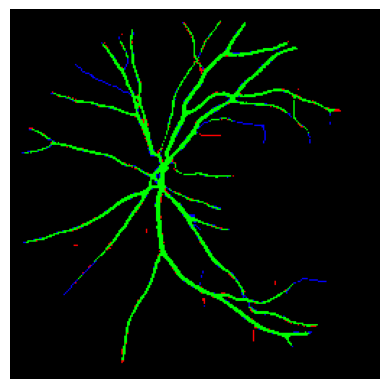

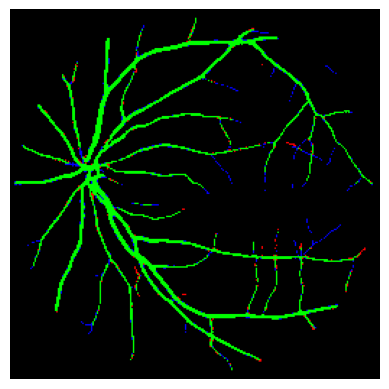

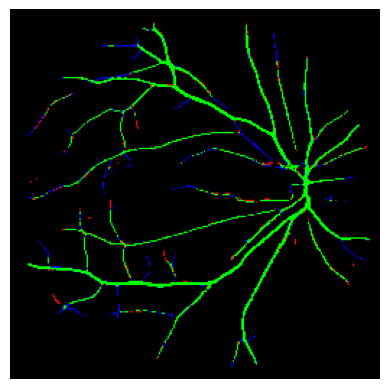

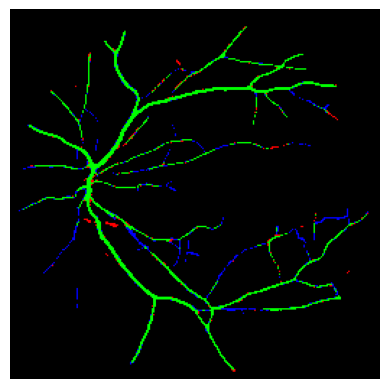

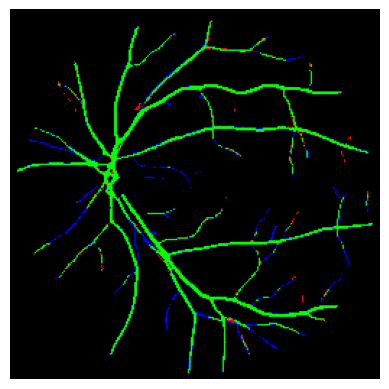

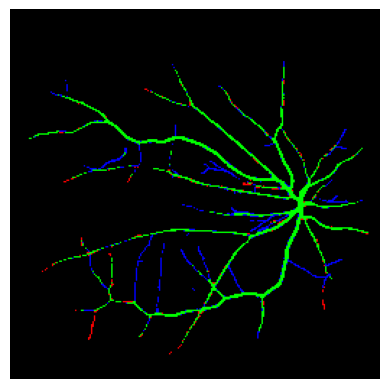

1/1 [==============================] - 0s 42ms/step


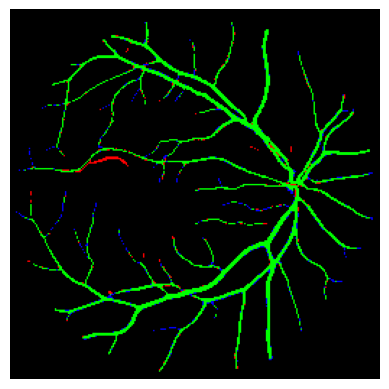

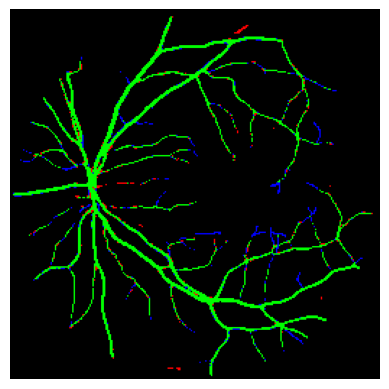

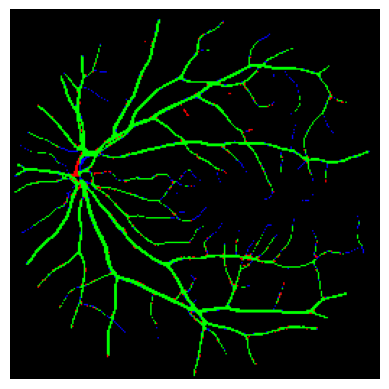

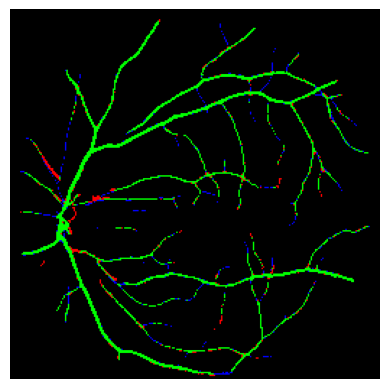

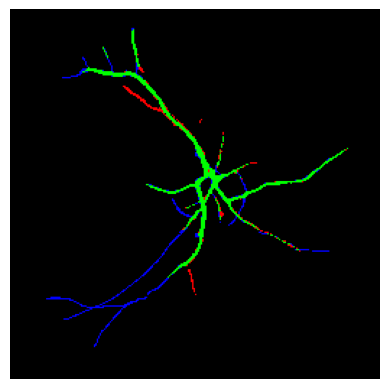

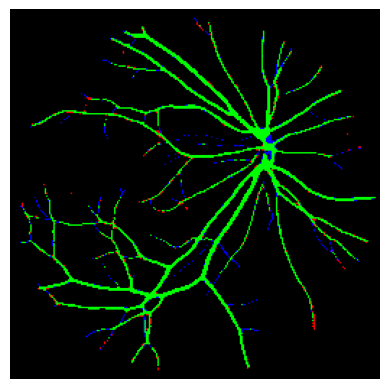

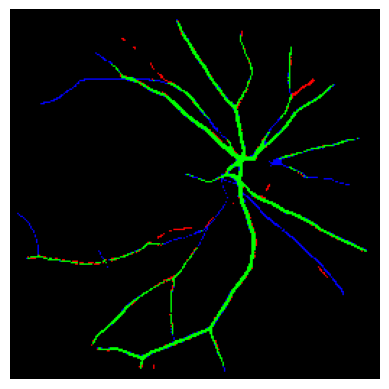

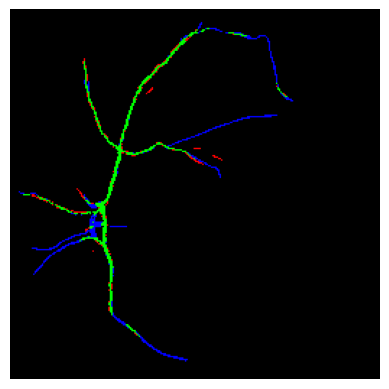

1/1 [==============================] - 0s 39ms/step


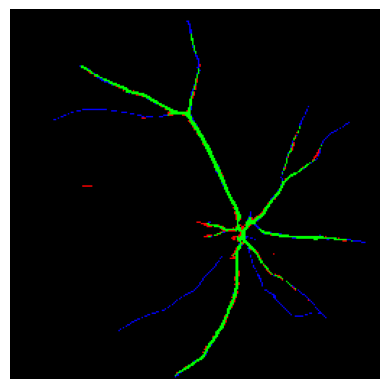

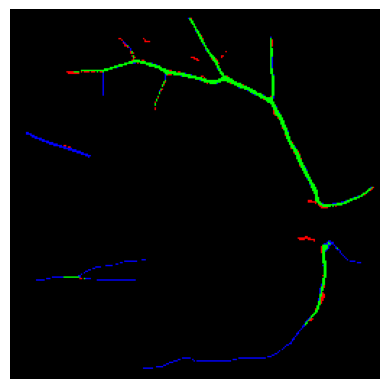

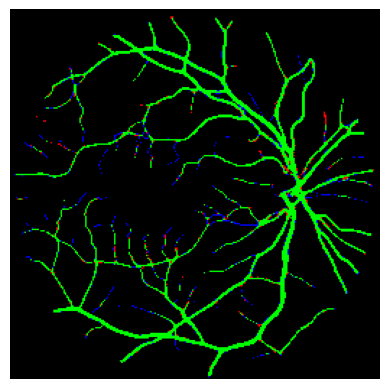

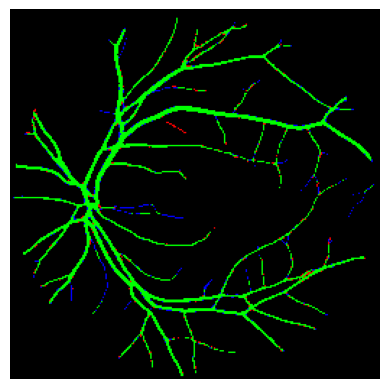

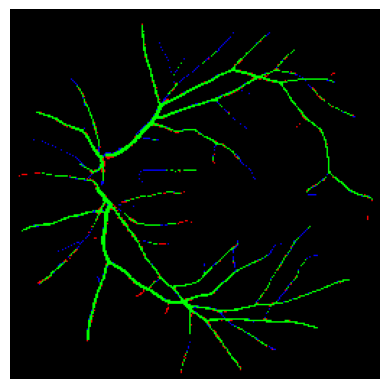

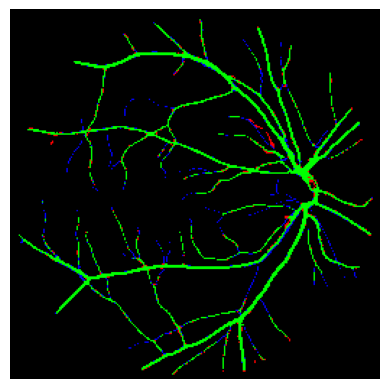

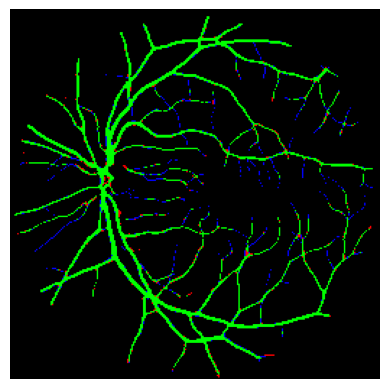

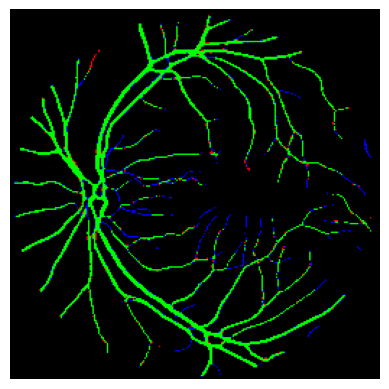

1/1 [==============================] - 0s 40ms/step


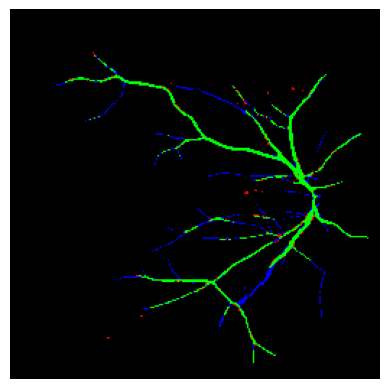

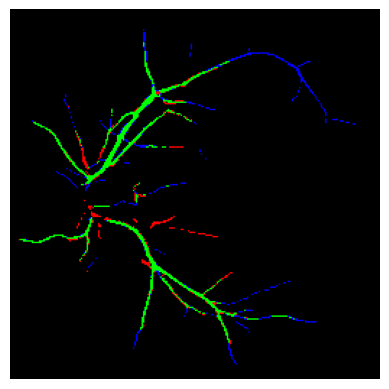

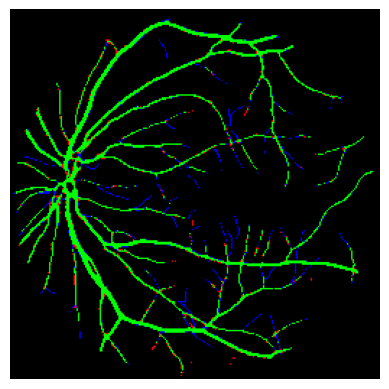

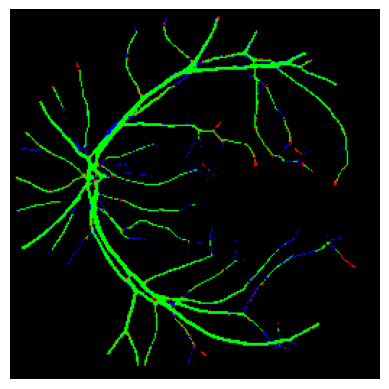

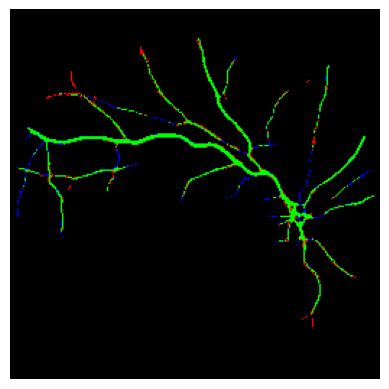

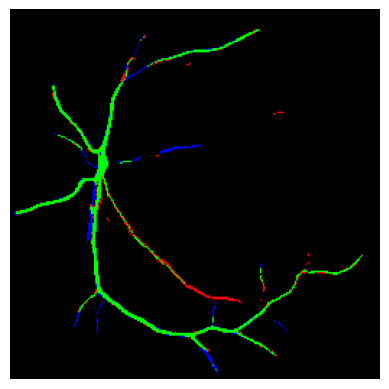

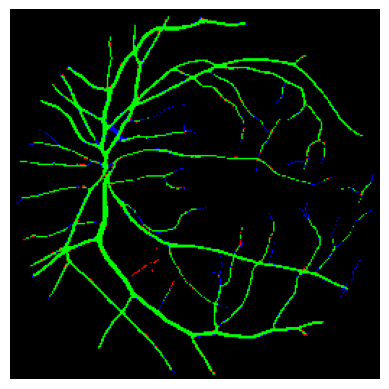

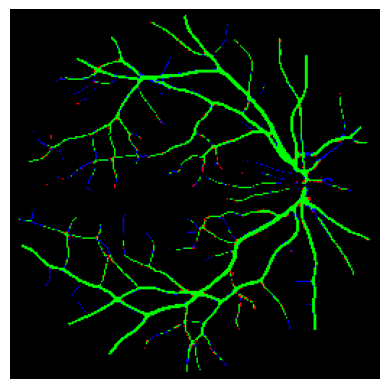

1/1 [==============================] - 0s 50ms/step


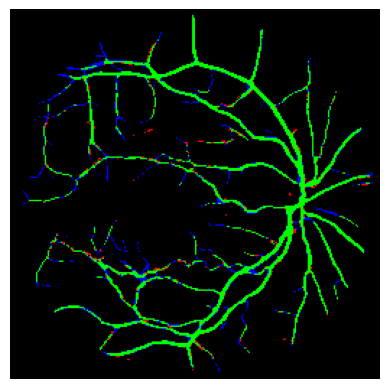

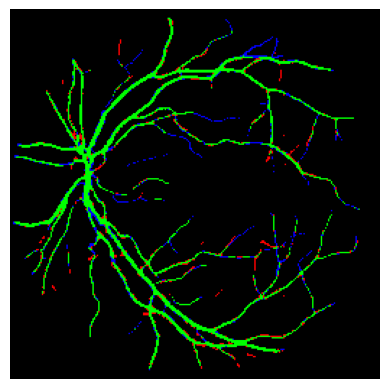

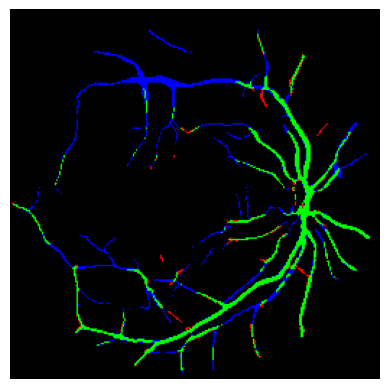

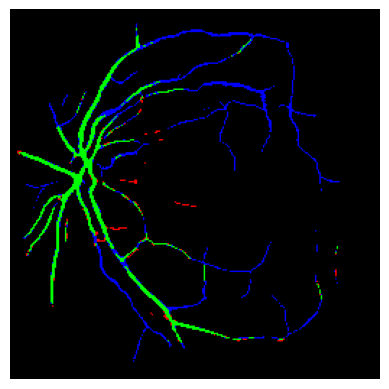

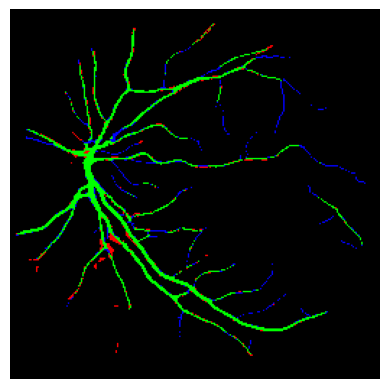

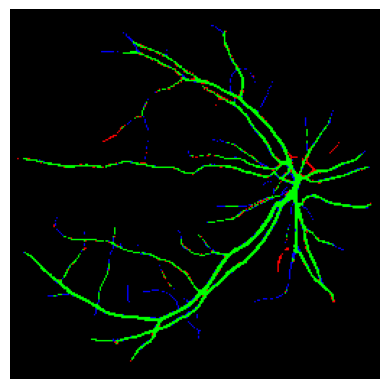

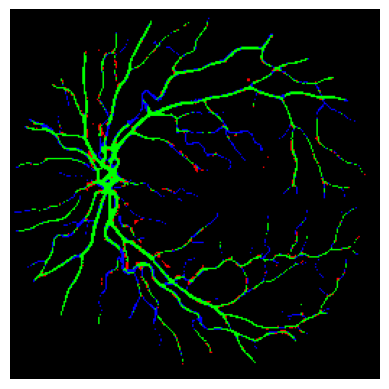

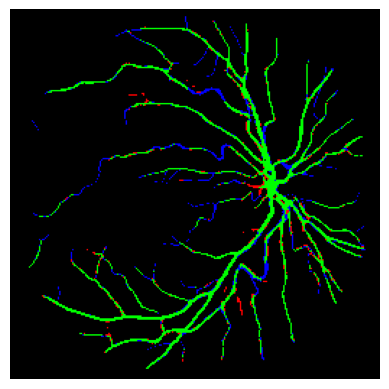

1/1 [==============================] - 0s 41ms/step


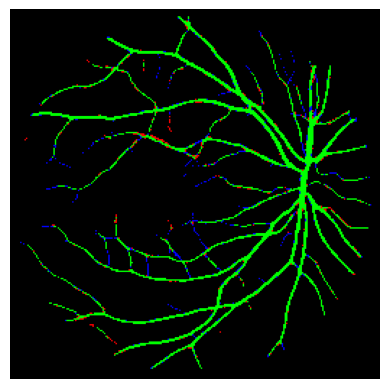

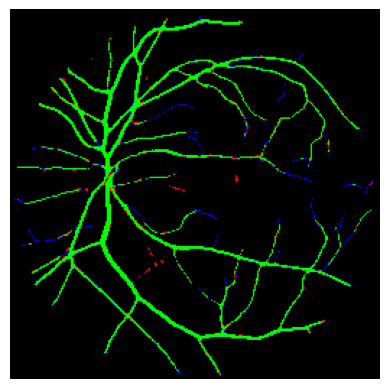

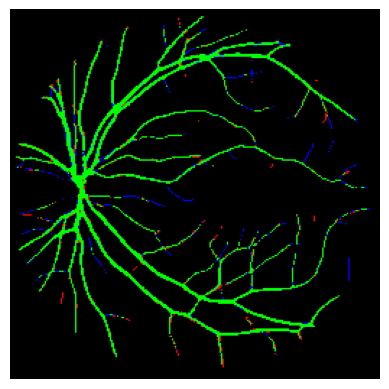

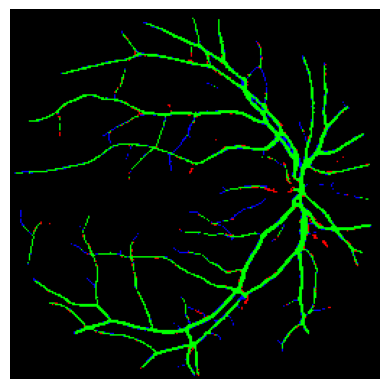

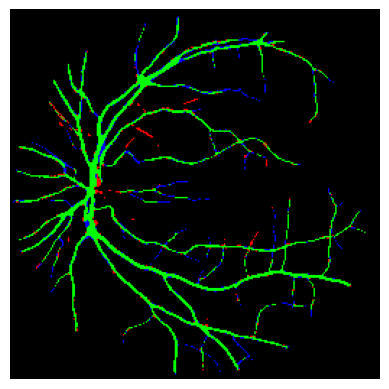

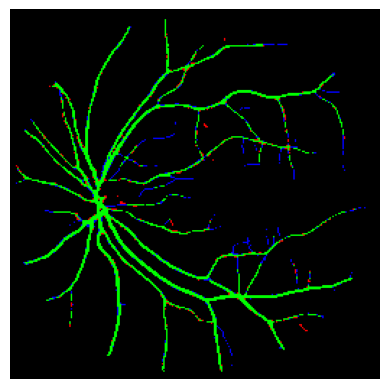

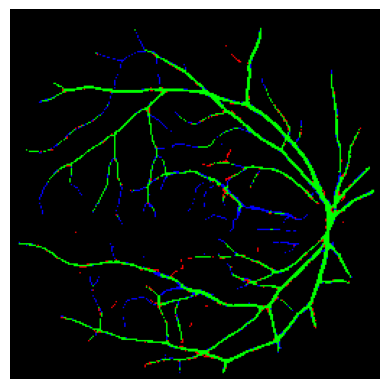

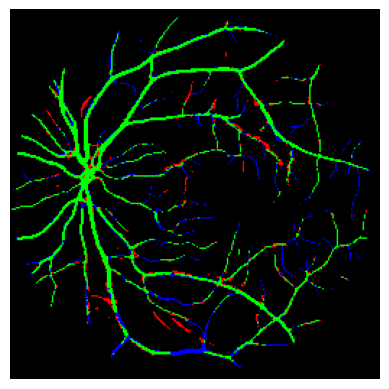

1/1 [==============================] - 0s 48ms/step


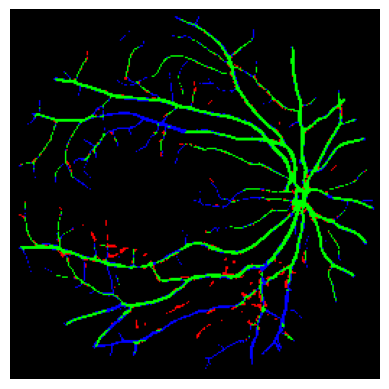

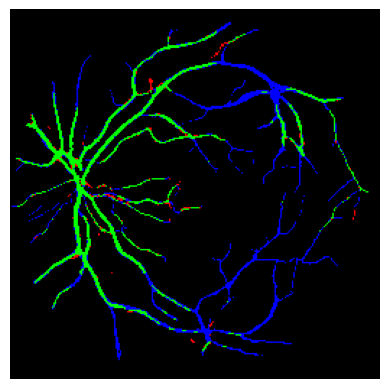

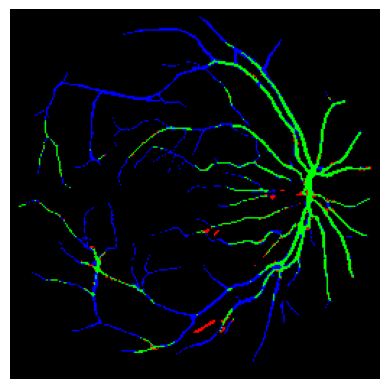

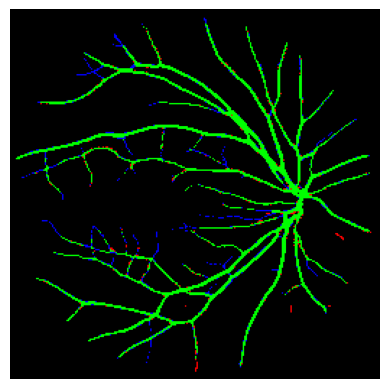

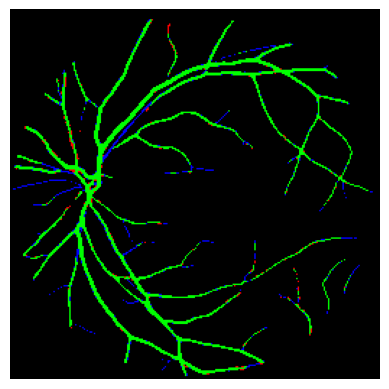

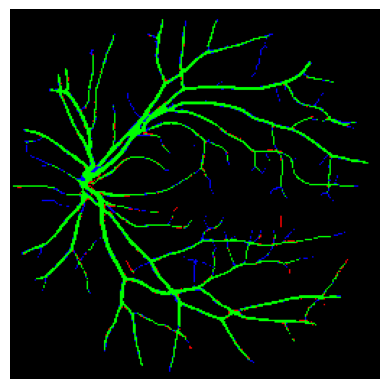

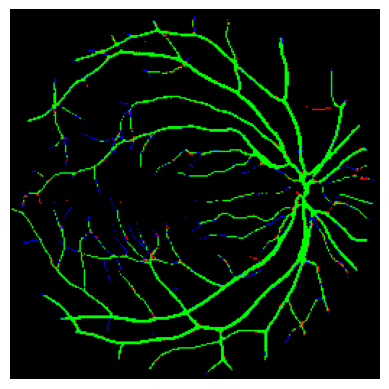

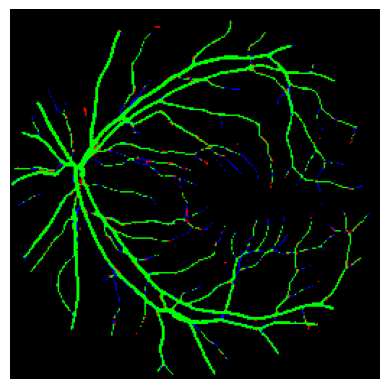

1/1 [==============================] - 0s 60ms/step


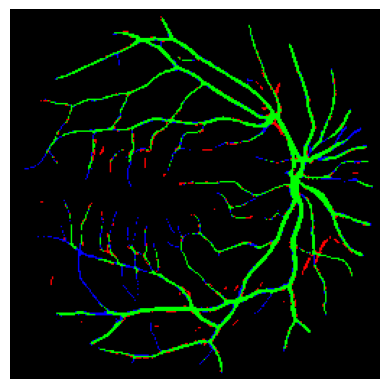

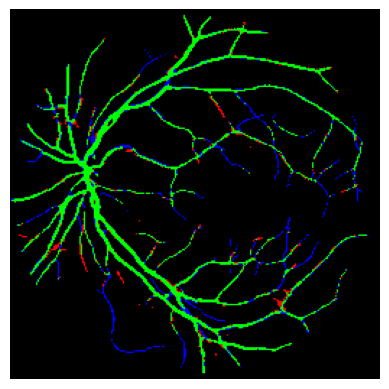

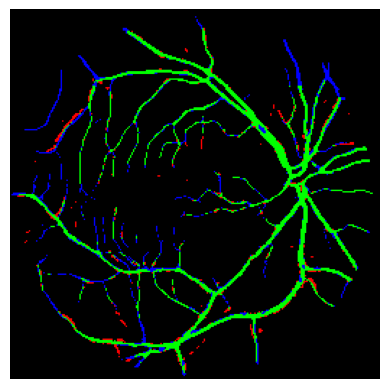

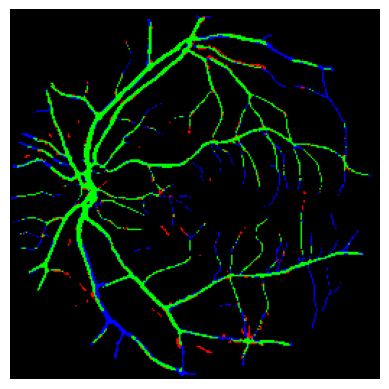

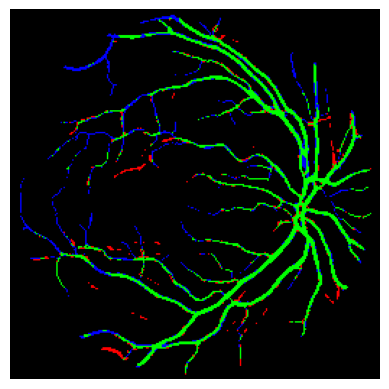

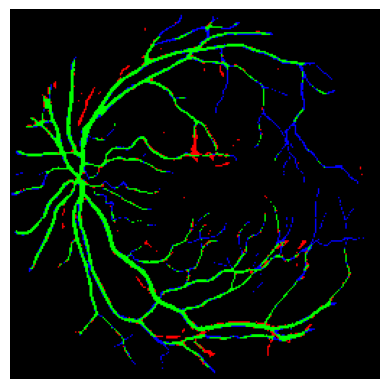

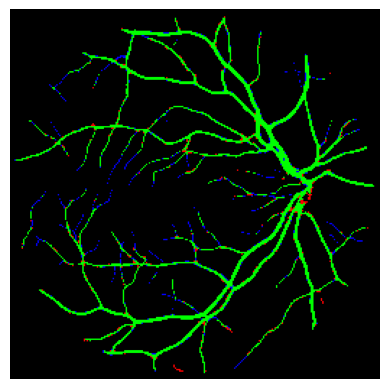

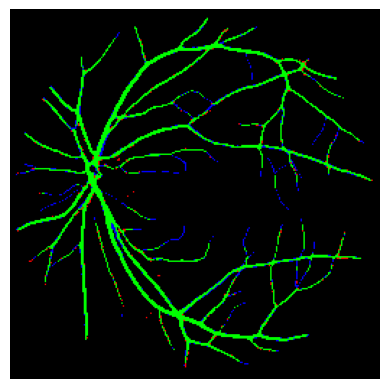

1/1 [==============================] - 0s 37ms/step


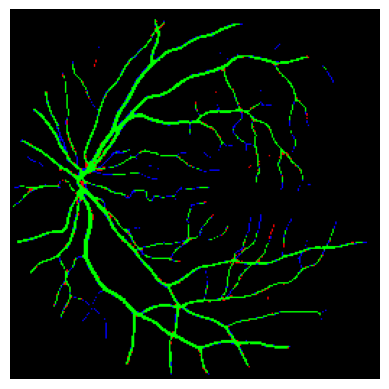

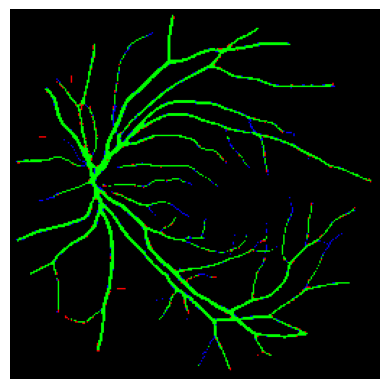

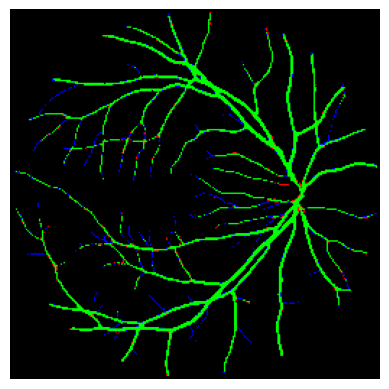

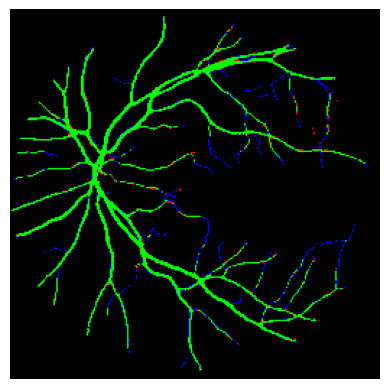

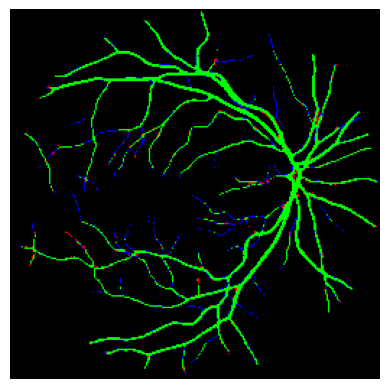

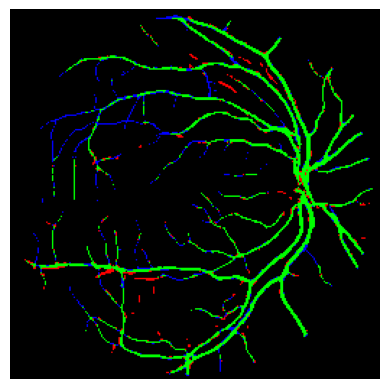

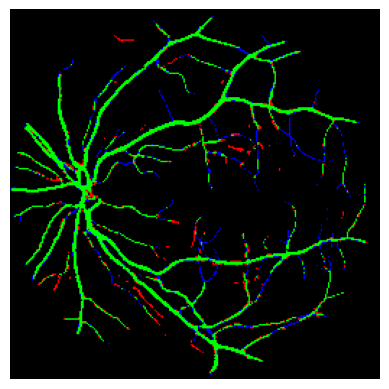

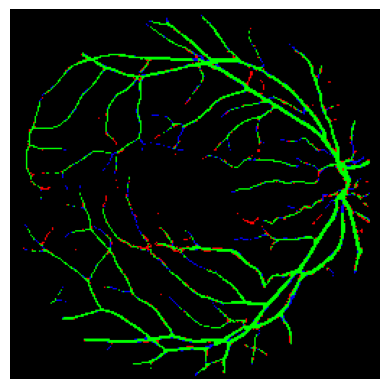

1/1 [==============================] - 0s 59ms/step


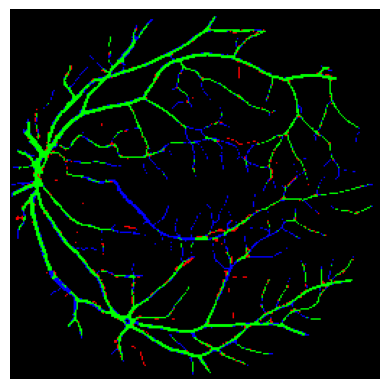

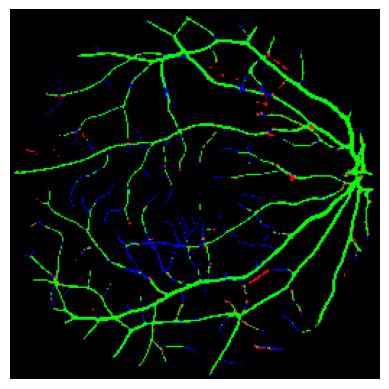

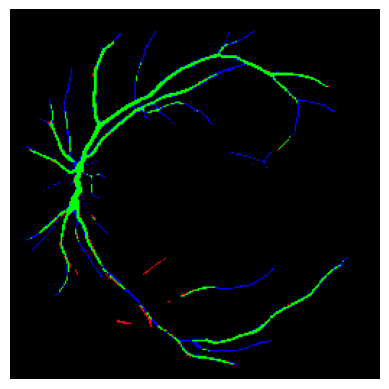

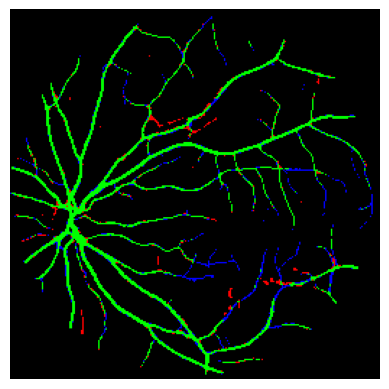

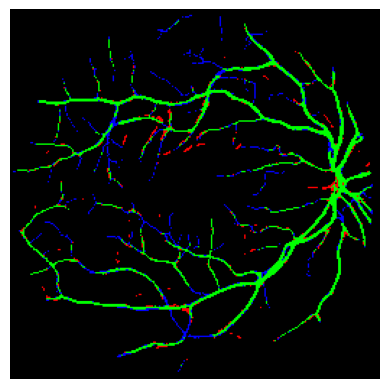

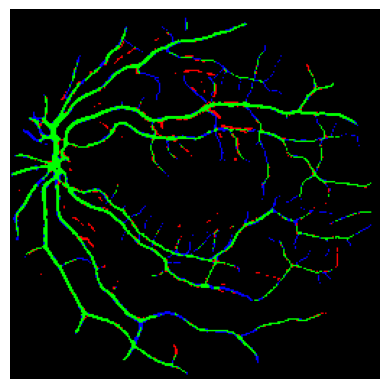

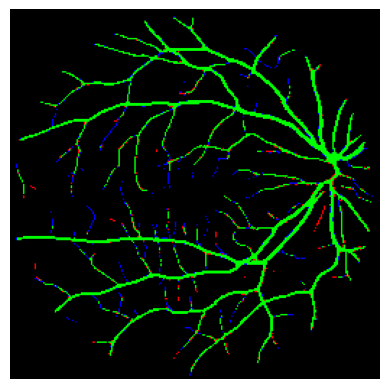

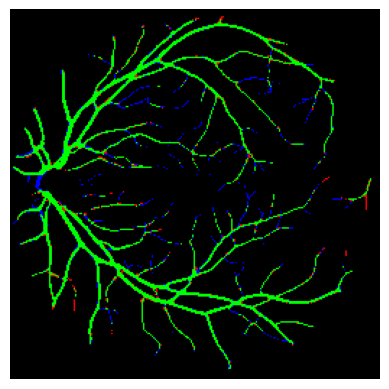

1/1 [==============================] - 0s 37ms/step


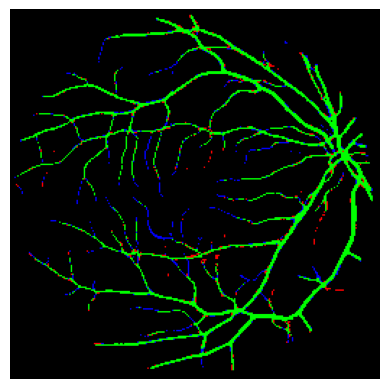

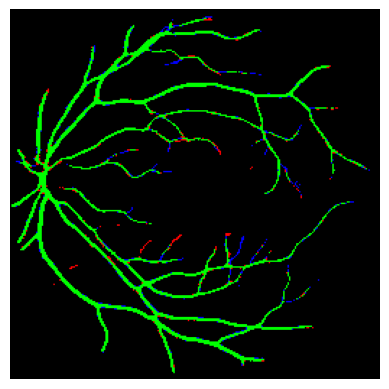

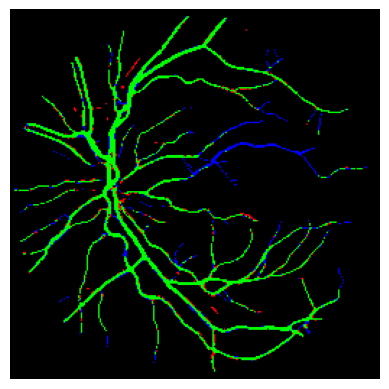

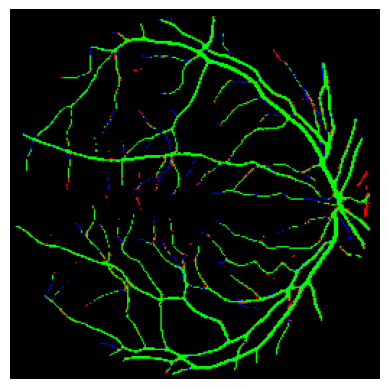

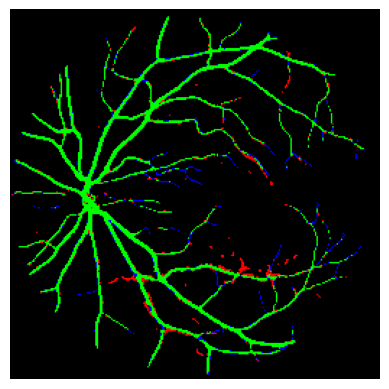

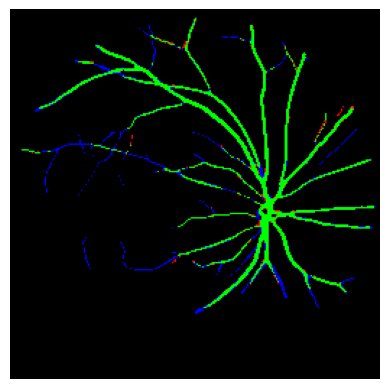

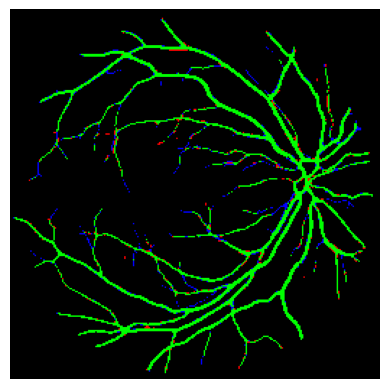

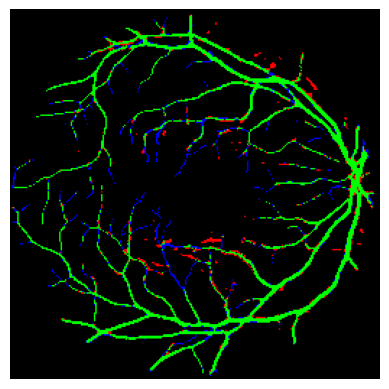

1/1 [==============================] - 0s 44ms/step


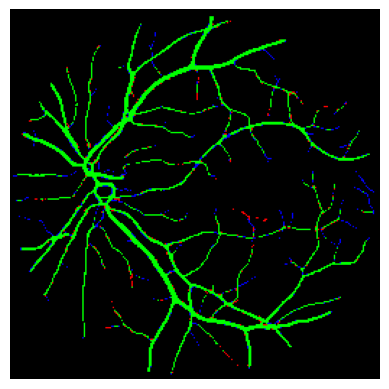

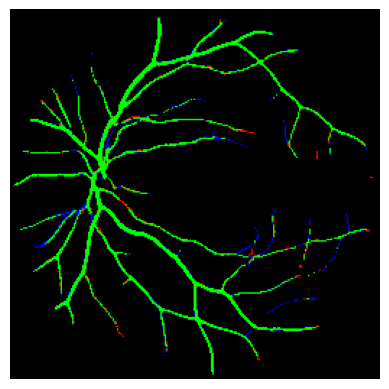

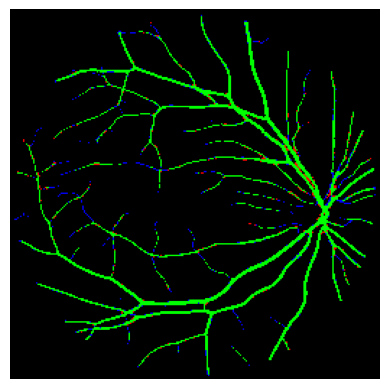

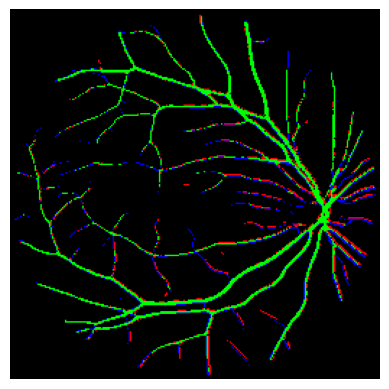

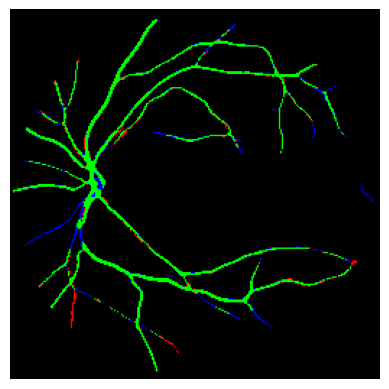

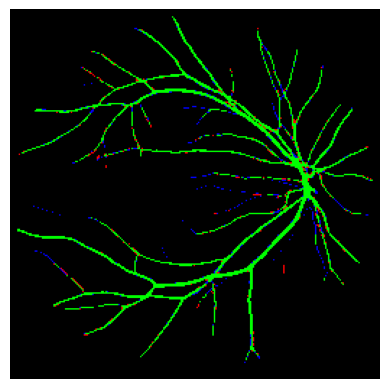

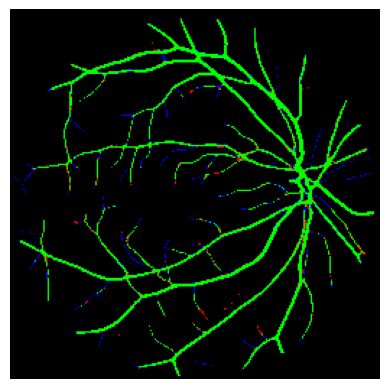

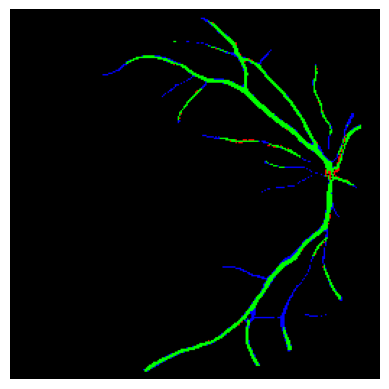

1/1 [==============================] - 0s 41ms/step


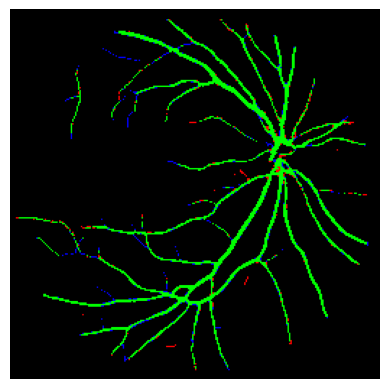

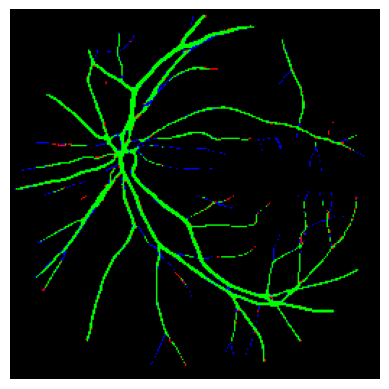

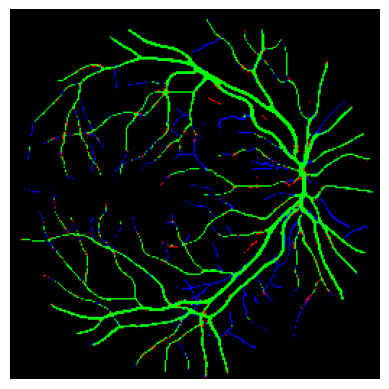

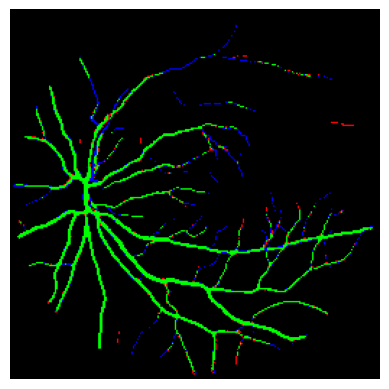

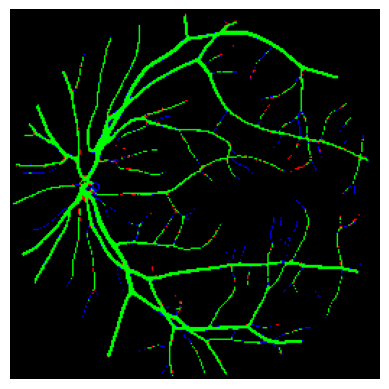

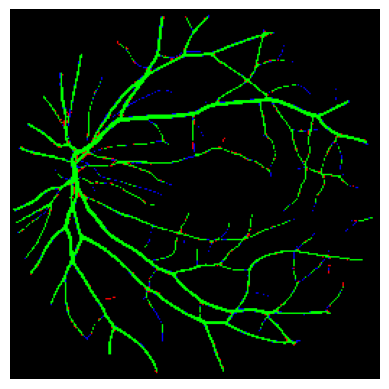

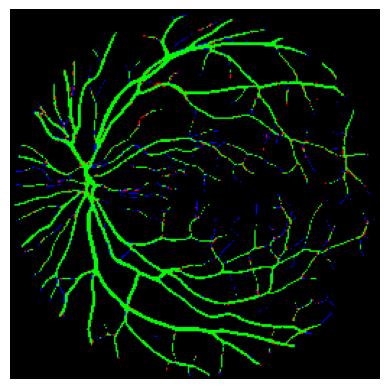

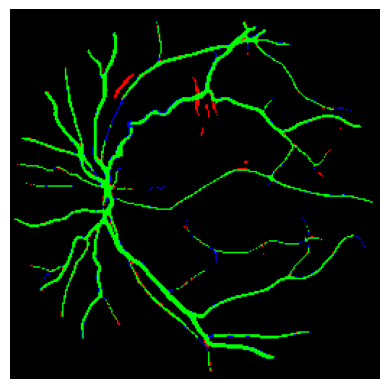

1/1 [==============================] - 0s 67ms/step


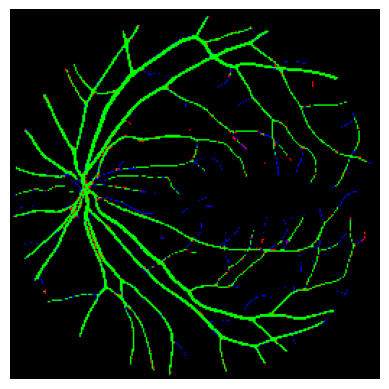

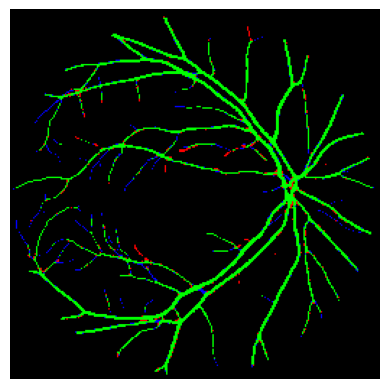

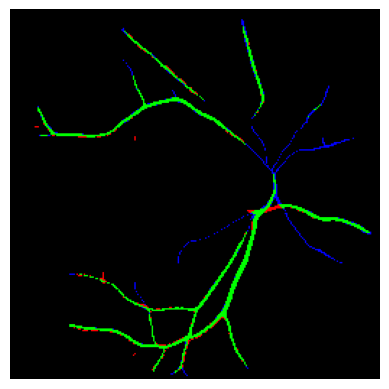

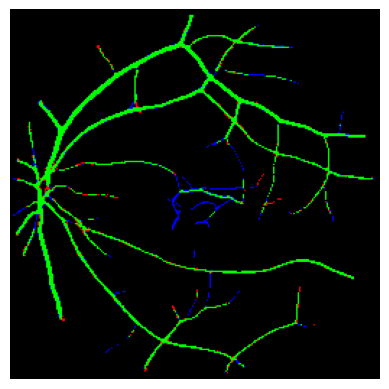

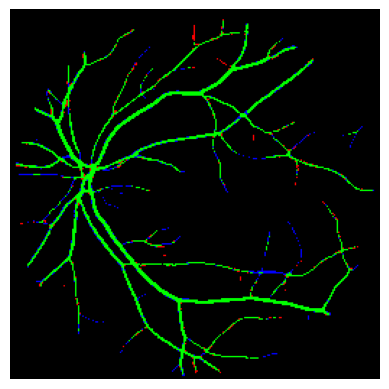

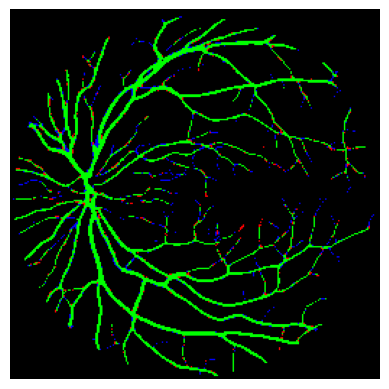

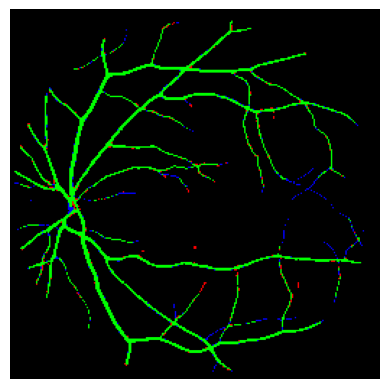

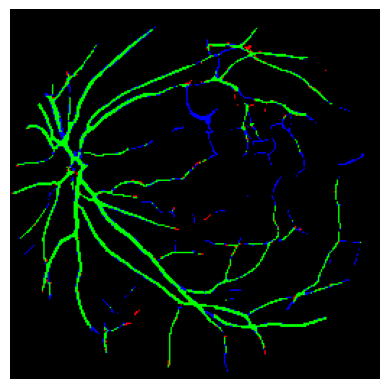

1/1 [==============================] - 0s 52ms/step


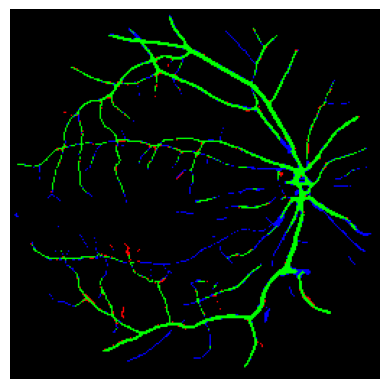

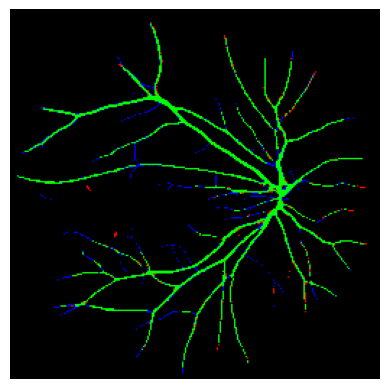

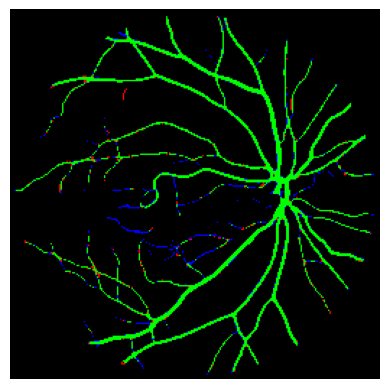

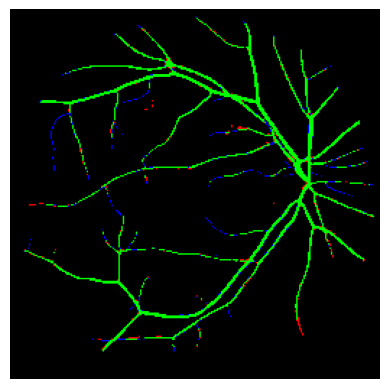

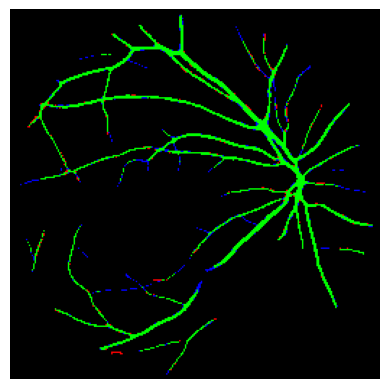

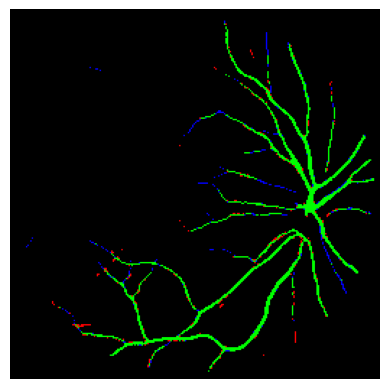

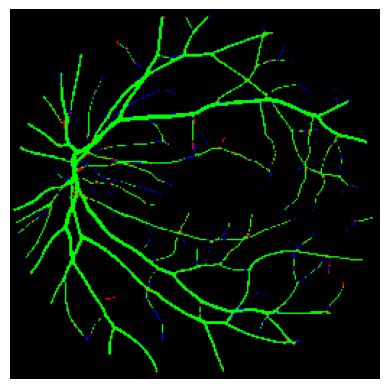

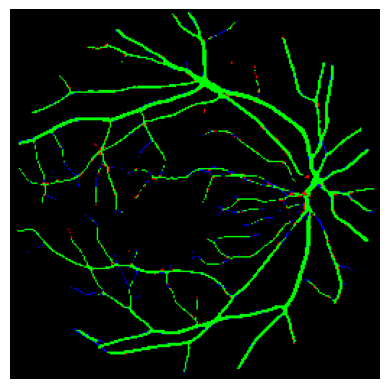

1/1 [==============================] - 0s 53ms/step


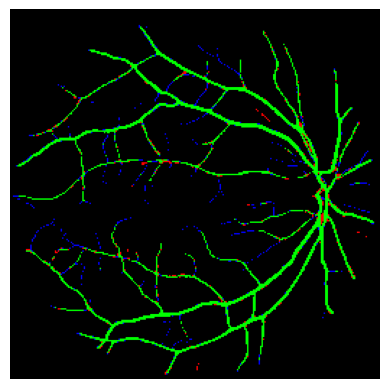

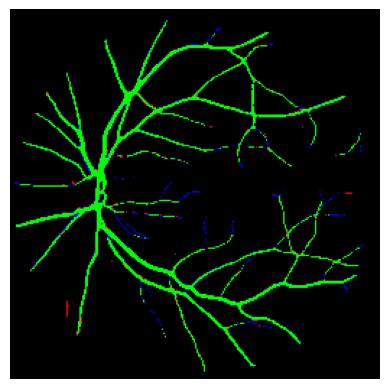

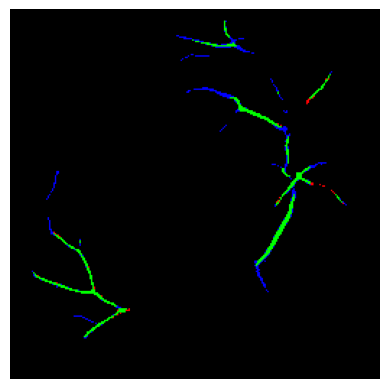

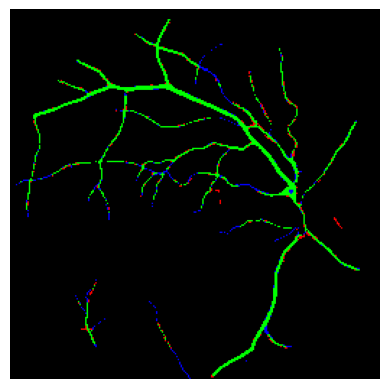

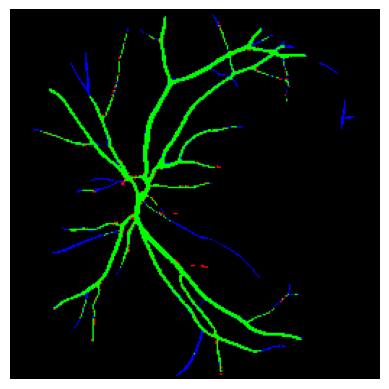

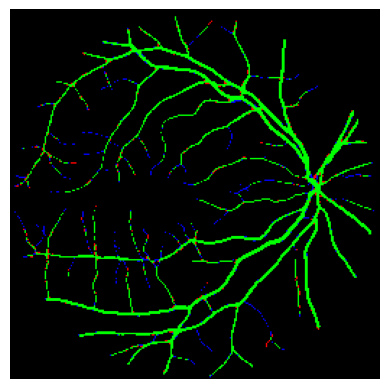

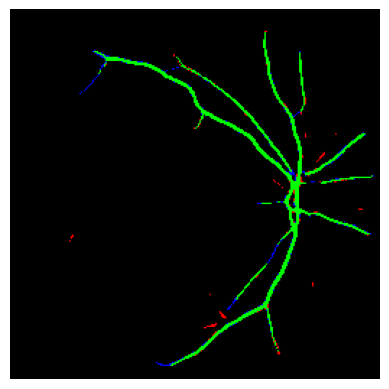

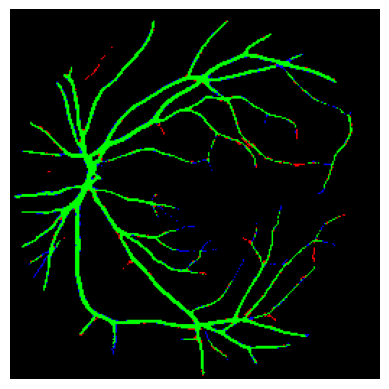

1/1 [==============================] - 0s 40ms/step


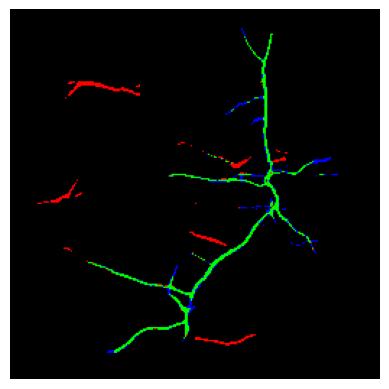

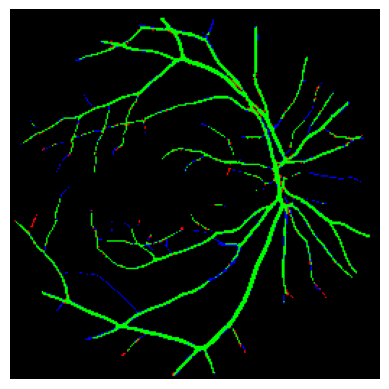

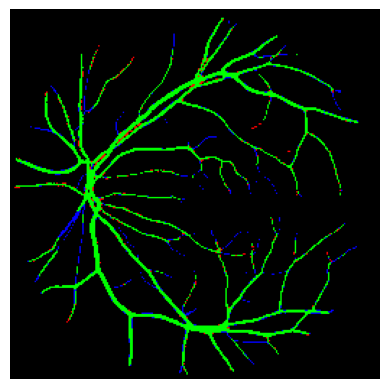

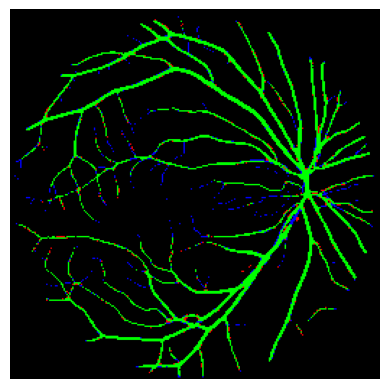

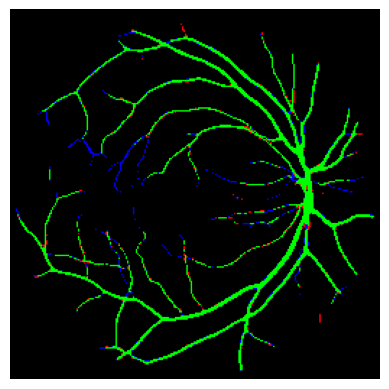

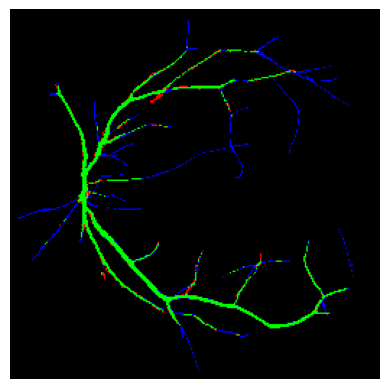

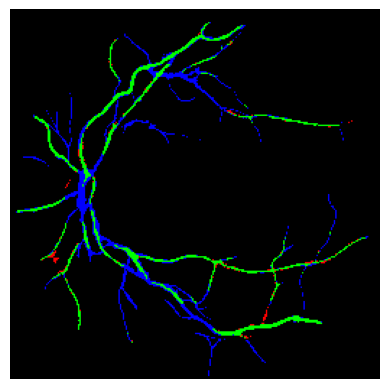

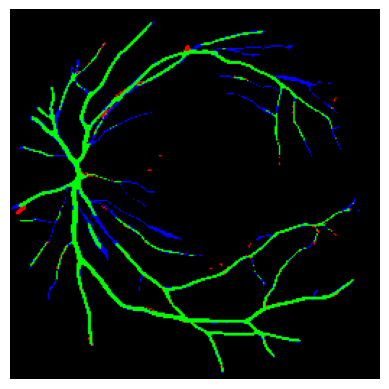

1/1 [==============================] - 0s 46ms/step


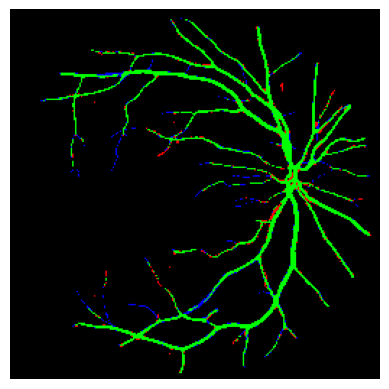

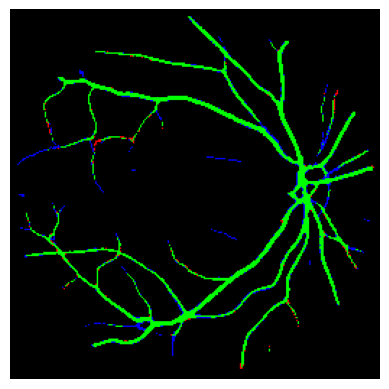

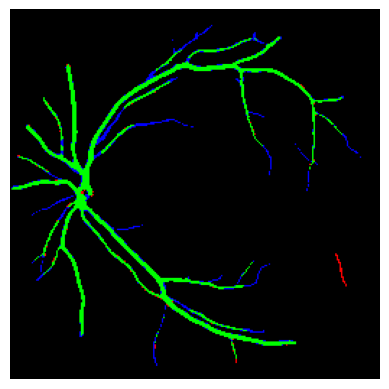

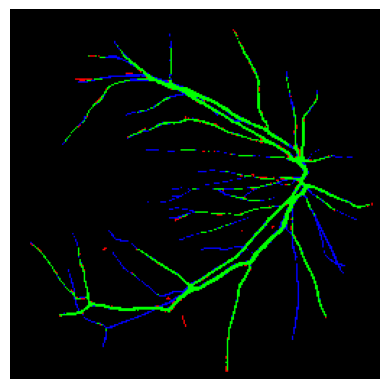

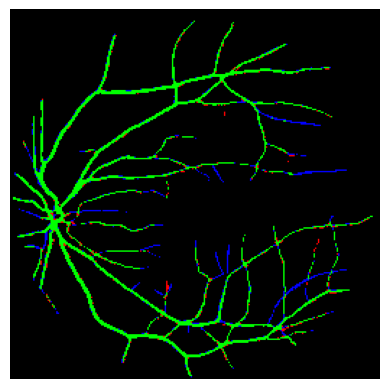

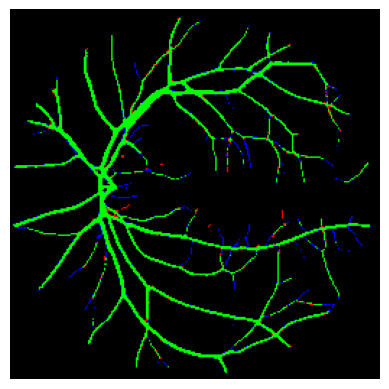

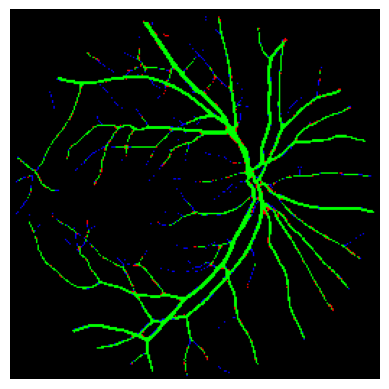

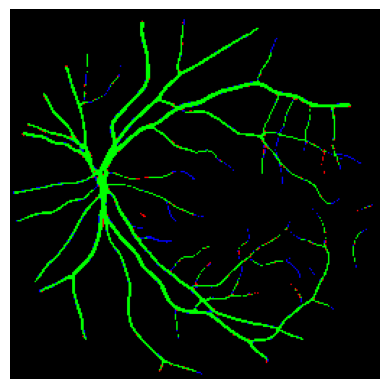

1/1 [==============================] - 0s 54ms/step


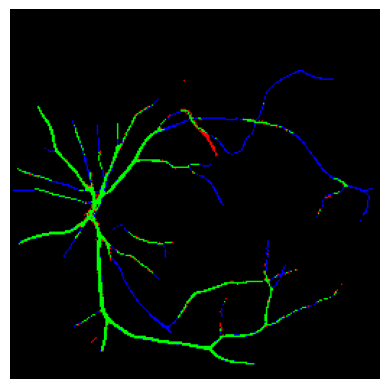

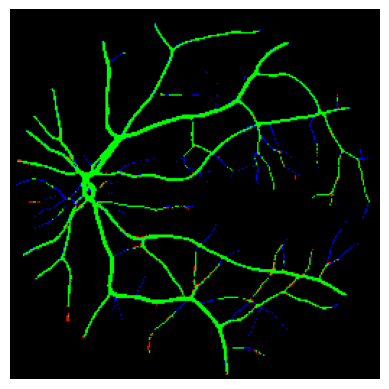

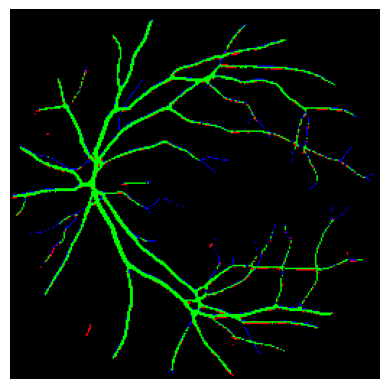

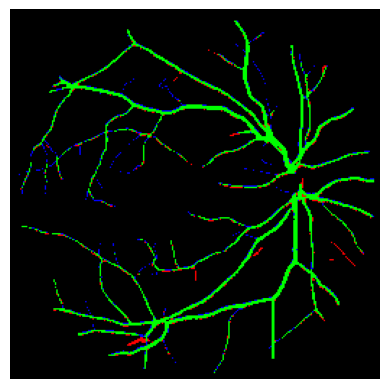

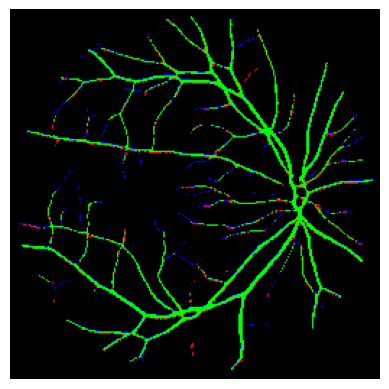

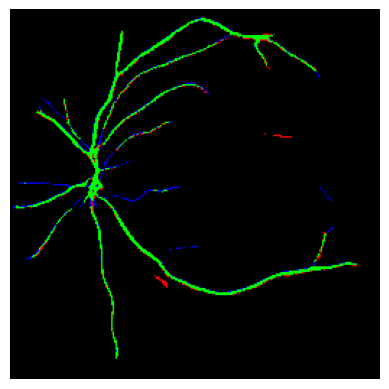

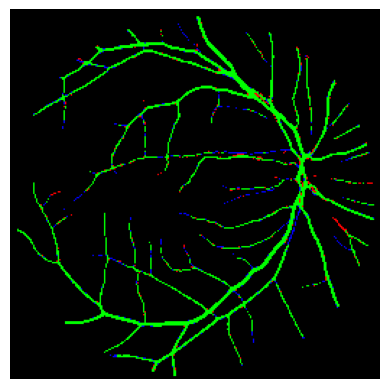

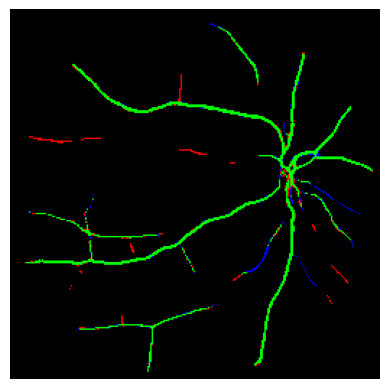

1/1 [==============================] - 0s 28ms/step


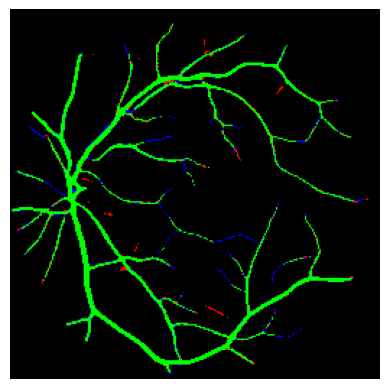

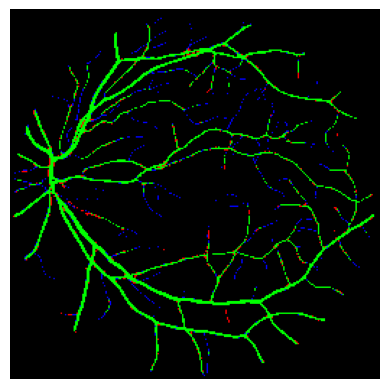

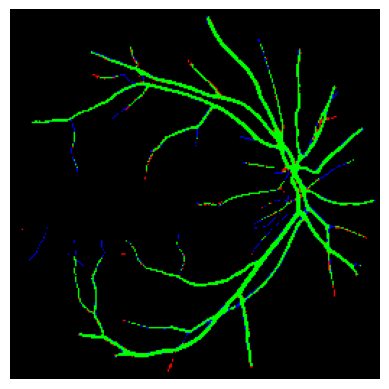

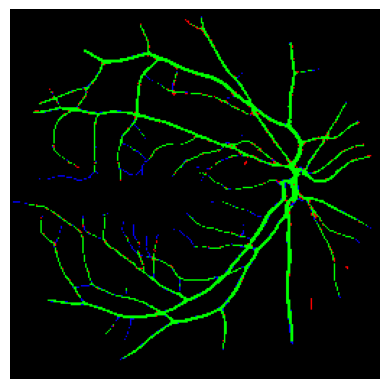

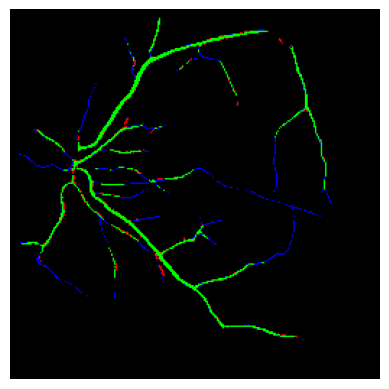

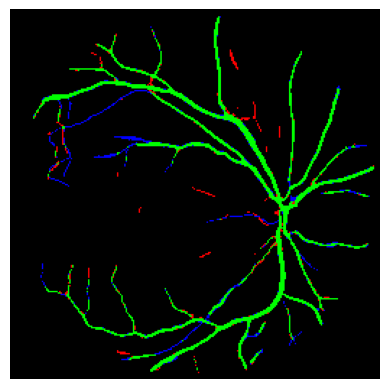

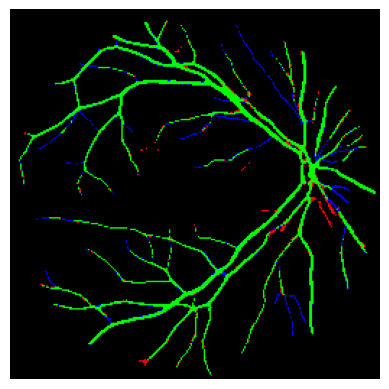

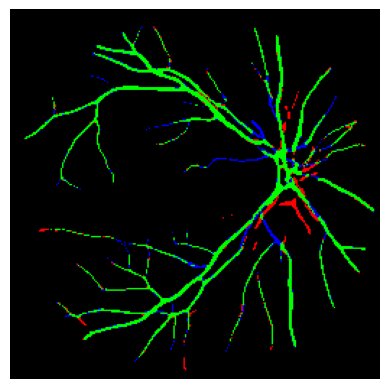

1/1 [==============================] - 0s 27ms/step


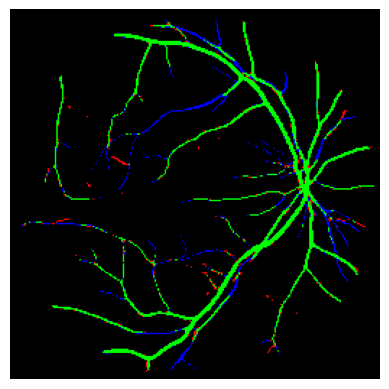

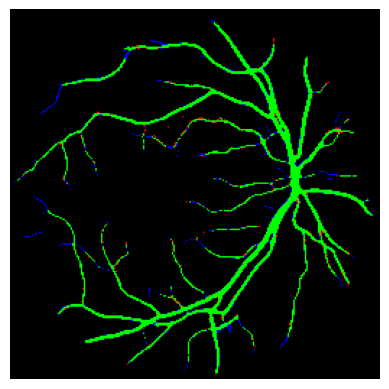

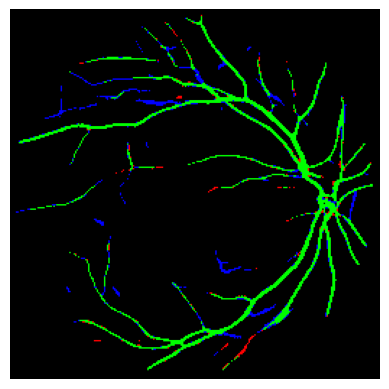

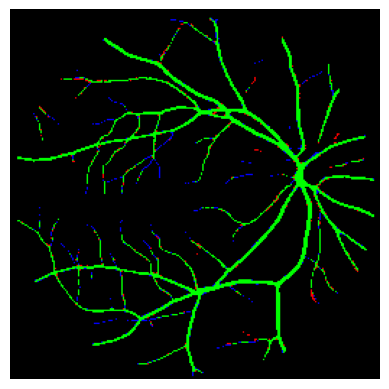

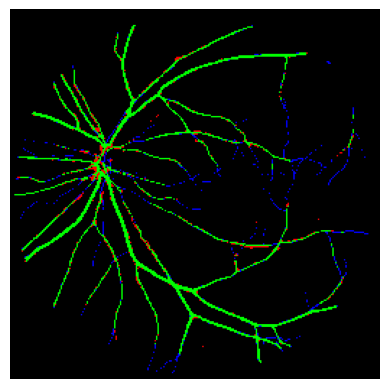

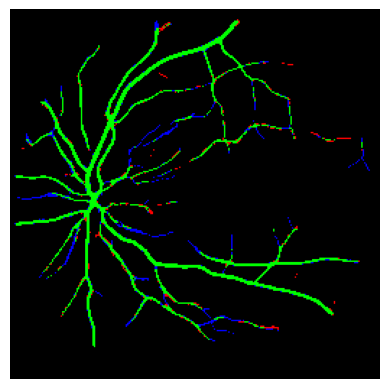

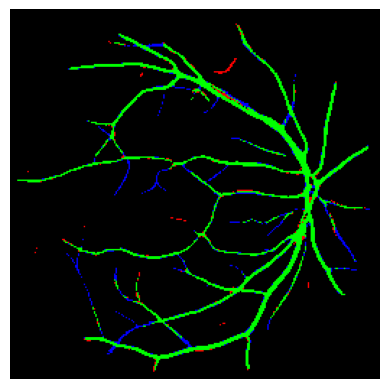

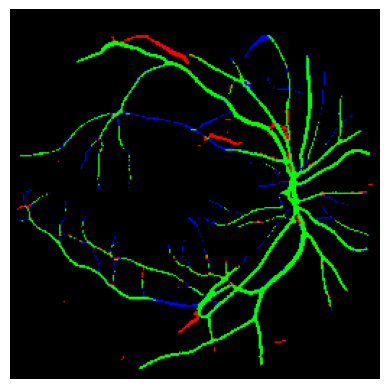

1/1 [==============================] - 0s 27ms/step


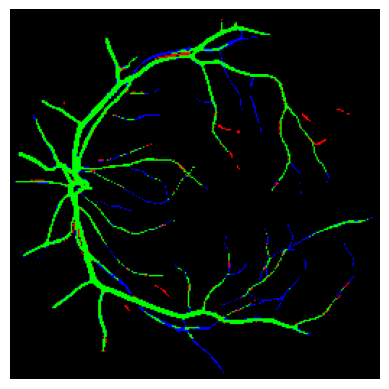

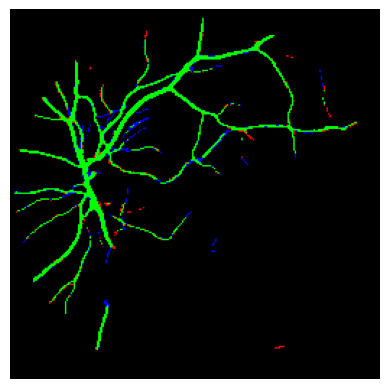

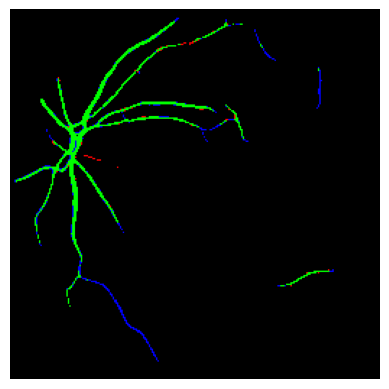

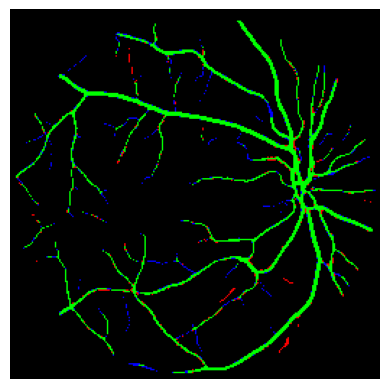

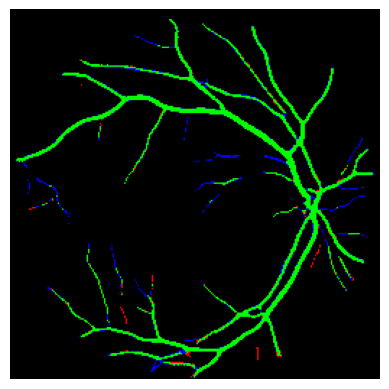

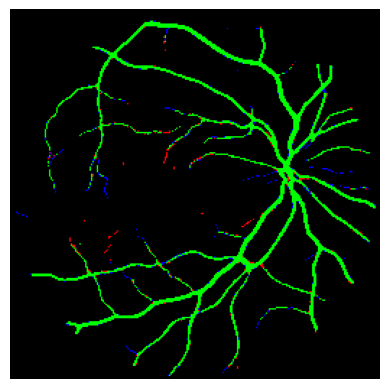

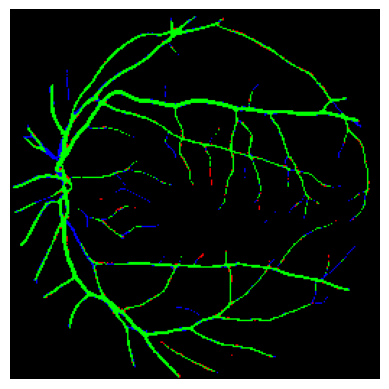

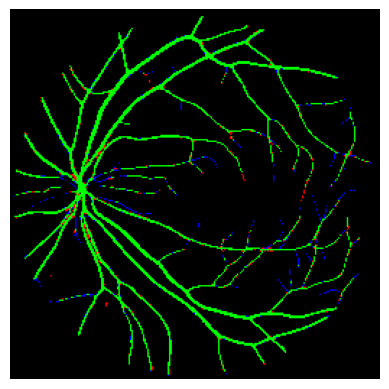

In [23]:
import matplotlib.pyplot as plt
import numpy as np

# true posivies (green), false positives (red), and false negatives (blue)
green = np.array([0, 1, 0])  # Green
red = np.array([1, 0, 0])    # Red
blue = np.array([0, 0, 1])   # Blue

# Create a function to apply the color mapping to the predicted binary mask and plot it
def plot_result_image(image, mask, model):
    # Predict the binary mask for the image using the model
    pred_mask = model.predict(image)

    pred_mask_binary = (pred_mask > 0.5).astype(np.float32)

    batch_size = image.shape[0]

    for i in range(batch_size):
        # Create a mask to visualize matching areas (green), false positives (red), and false negatives (blue)
        match_mask = np.zeros(image[i].shape)

        # where predicted and ground truth masks both equal 1
        match_mask[(pred_mask_binary[i, ..., 0] == 1) & (mask[i, ..., 0] == 1)] = green  # Green (matching)

        # where predicted mask is 1 but ground truth mask is 0
        match_mask[(pred_mask_binary[i, ..., 0] == 1) & (mask[i, ..., 0] == 0)] = red  # Red (false positive)

        # where predicted mask is 0 but ground truth mask is 1
        match_mask[(pred_mask_binary[i, ..., 0] == 0) & (mask[i, ..., 0] == 1)] = blue  # Blue (false negative)

        # Display the result image
        plt.imshow(match_mask)
        plt.axis('off')
        plt.show()

for image, mask in test_dataset:
    plot_result_image(image, mask, m1)


In [24]:
#Test on DRIVE dataset
import os

#Define the paths to the drive dataset folders

drive_image_folder = '/content/drive/MyDrive/Drive_dataset/Images_png/'
drive_mask_folder = '/content/drive/MyDrive/Drive_dataset/Masks_png'

drive_image_files = os.listdir(drive_image_folder)
drive_mask_files = os.listdir(drive_mask_folder)

drive_image_paths = [os.path.join(drive_image_folder, filename) for filename in drive_image_files]
drive_mask_paths = [os.path.join(drive_mask_folder, filename) for filename in drive_mask_files]

drive_image_paths = sorted(drive_image_paths)
drive_mask_paths = sorted(drive_mask_paths)


In [25]:
import tensorflow as tf

IMAGE_SIZE = 256
BATCH_SIZE = 20

def read_image(image_path, mask=False):
    image = tf.io.read_file(image_path)

    if mask:
        image = tf.image.decode_png(image, channels=1)
        image = tf.cast(image, tf.float32) / 255.0  # Normalize to [0, 1] for mask images
        image = tf.where(image >= 0.5, 1.0, 0.0)
        image = tf.image.resize(image, [IMAGE_SIZE, IMAGE_SIZE])
    else:
        image = tf.image.decode_png(image, channels=3)
        image = tf.cast(image, tf.float32) / 255.0  # Normalize to [0, 1] for RGB images
        image = tf.image.resize(image, [IMAGE_SIZE, IMAGE_SIZE])

    return image

def load_data(image_list, mask_list):
    image = read_image(image_list)
    mask = read_image(mask_list, mask=True)
    return image, mask

def data_generator(image_list, mask_list):
    dataset = tf.data.Dataset.from_tensor_slices((image_list, mask_list))
    dataset = dataset.map(load_data, num_parallel_calls=tf.data.AUTOTUNE)
    dataset = dataset.batch(BATCH_SIZE, drop_remainder=True)
    return dataset

drive_dataset = data_generator(drive_image_paths, drive_mask_paths)

print("Test Dataset:", drive_dataset)



Test Dataset: <_BatchDataset element_spec=(TensorSpec(shape=(20, 256, 256, 3), dtype=tf.float32, name=None), TensorSpec(shape=(20, 256, 256, 1), dtype=tf.float32, name=None))>


In [26]:
def calculate_metrics(model, drive_dataset):
    accuracy_scores = []
    dice_scores = []
    tp_scores = []
    tn_scores = []
    fp_scores = []
    fn_scores = []

    for image, mask in drive_dataset:

        pred_mask = model.predict(image)


        mask = mask.numpy()

        pred_mask_binary = (pred_mask > 0.5).astype(np.float32)

        mask_flat = mask.flatten()
        pred_mask_flat = pred_mask_binary.flatten()

        # Calculate True Positives, True Negatives, False Positives, and False Negatives
        tp = np.sum(mask_flat * pred_mask_flat)
        tn = np.sum((1 - mask_flat) * (1 - pred_mask_flat))
        fp = np.sum((1 - mask_flat) * pred_mask_flat)
        fn = np.sum(mask_flat * (1 - pred_mask_flat))

        # Calculate accuracy, Dice score
        accuracy = (tp + tn) / (tp + tn + fp + fn)
        dice = (2.0 * tp) / (2.0 * tp + fp + fn)

        accuracy_scores.append(accuracy)
        dice_scores.append(dice)
        tp_scores.append(tp)
        tn_scores.append(tn)
        fp_scores.append(fp)
        fn_scores.append(fn)

    # Calculate and print average accuracy and Dice scores
    avg_accuracy = np.mean(accuracy_scores)
    avg_dice = np.mean(dice_scores)

    print(f"Average Accuracy: {avg_accuracy:.4f}")
    print(f"Average Dice Score: {avg_dice:.4f}")

    TP = np.mean(tp_scores)
    TN = np.mean(tn_scores)
    FP = np.mean(fp_scores)
    FN = np.mean(fn_scores)

    f1 = 2 * TP / (2 * TP + FP + FN)
    recall = TP/(FN+TP)
    precision = TP/(TP+FP)
    specificity = TN/(FP+TN)
    MCC = (TP*TN - FP*FN)/ np.sqrt((TP+FP)*(TP+FN)*(TN+FP)*(TN+FN))

    print("Precision Score:", precision)
    print("Sensitivity/Recall Score:", recall)
    print("Specificity Score:", specificity)
    print("F1 Score:", f1)
    print("MCC :", MCC)



calculate_metrics(m1, drive_dataset)


1/1 [==============================] - 5s 5s/step
Average Accuracy: 0.9570
Average Dice Score: 0.7232
Precision Score: 0.8138666
Sensitivity/Recall Score: 0.65074164
Specificity Score: 0.9859345
F1 Score: 0.7232198776095823
MCC : 0.7053684


1/1 [==============================] - 0s 27ms/step


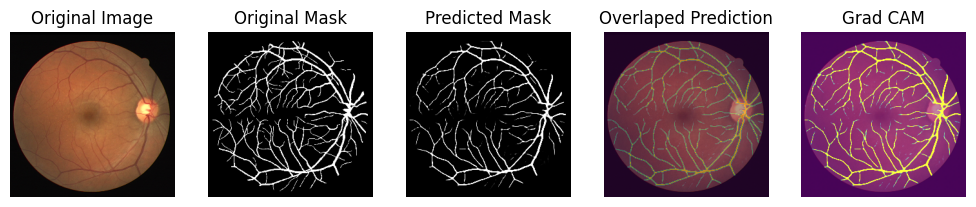

1/1 [==============================] - 0s 24ms/step


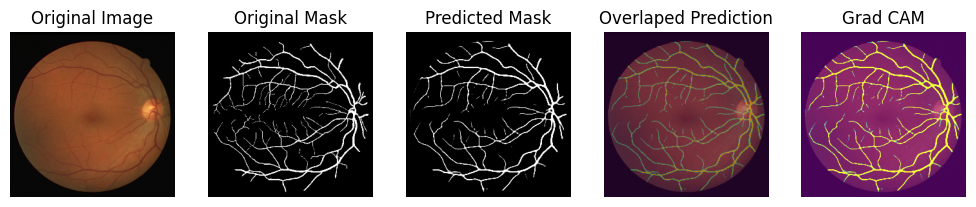

1/1 [==============================] - 0s 24ms/step


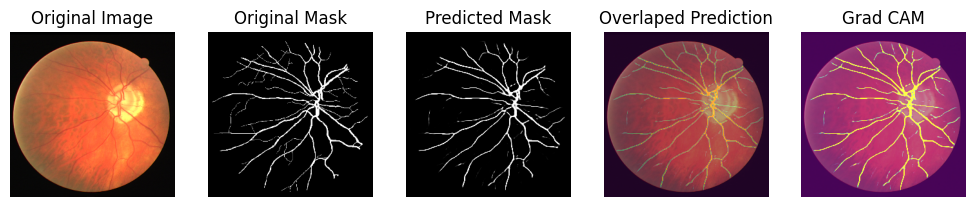

1/1 [==============================] - 0s 24ms/step


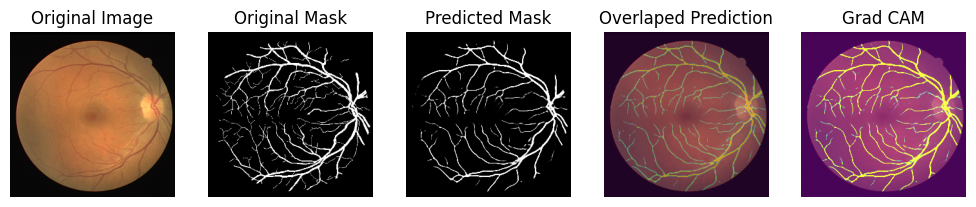

1/1 [==============================] - 0s 24ms/step


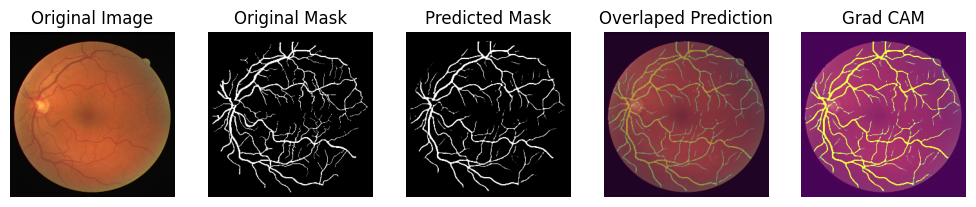

1/1 [==============================] - 0s 24ms/step


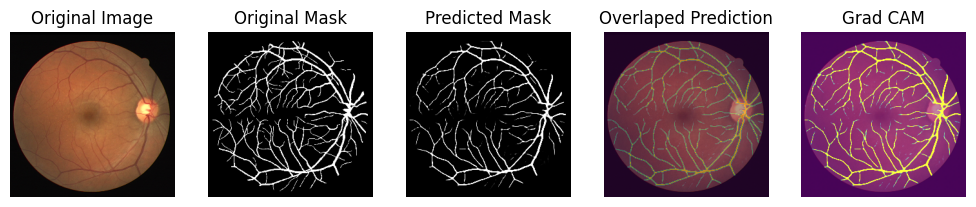

1/1 [==============================] - 0s 24ms/step


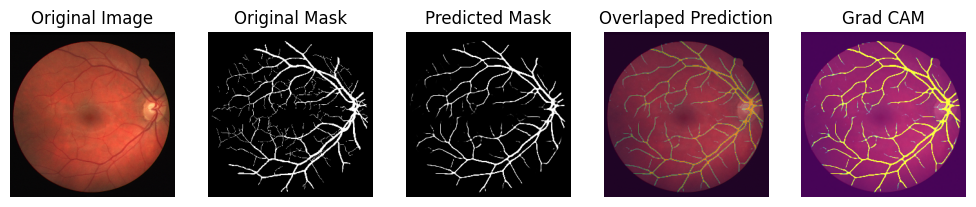

1/1 [==============================] - 0s 25ms/step


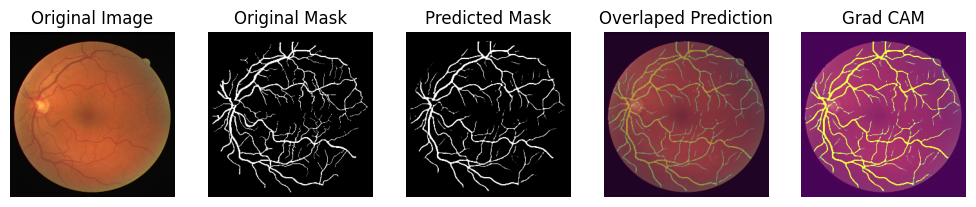

1/1 [==============================] - 0s 25ms/step


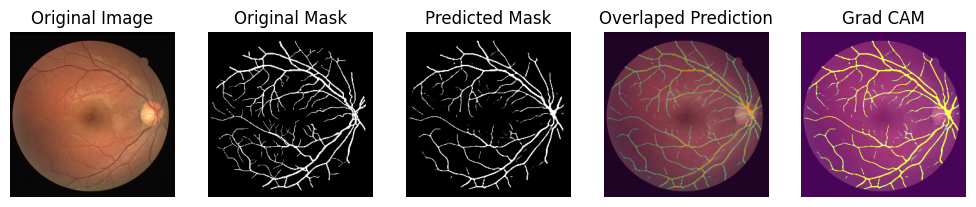

1/1 [==============================] - 0s 25ms/step


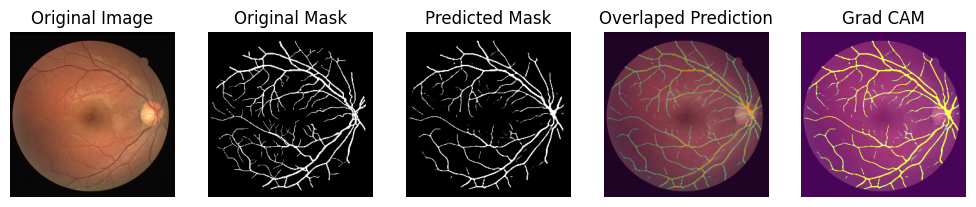

In [28]:
show_images(drive_dataset, model=m1, explain=True, n_images=10, SIZE=(20,8))